# **DETECCIÓN DE JUGADORES CON YOLO Y CÁLCULO DE MÉTRICAS**

En este notebook se presenta el módulo encargado de la detección de jugadores en partidos de tenis mediante un detector basado en aprendizaje profundo (YOLO), así como el posterior cálculo de métricas derivadas a partir de las detecciones obtenidas en cada frame.

Para la selección robusta de tenistas se hará uso de técnicas ya implementadas en notebooks previos como `TennisCourtDetector.ipynb` y `PlayerMapPosition.ipynb`.

## **DATASET: TRACKNET**

Estas primeras celdas de código son **comunes** en el resto de notebooks, encargadas de **cargar y preparar el conjunto de datos** que se utilizará a lo largo del proyecto para **validar** tanto **el comportamiento de los modelos entrenados** como **las técnicas de procesado de imágenes** implementadas.

Para facilitar el acceso al dataset, que se encuentra en la plataforma **Kaggle**, se establece el acceso a Google Drive, donde se va a guardar la **clave de autenticación de usuario** (`kaggle.json`) de dicha plataforma para poder descargarlo directamente desde sus servidores.




In [ ]:
from google.colab import drive
import os
import sys

drive.mount('/content/drive')
sys.path.append('/content/drive/MyDrive/tenis_functions')

!mkdir -p ~/.kaggle

!cp /content/drive/MyDrive/dataset_tennis/kaggle.json ~/.kaggle/

!chmod 600 ~/.kaggle/kaggle.json

print("¡Llave copiada con éxito!")
!ls -l ~/.kaggle
!kaggle datasets list | head

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
¡Llave copiada con éxito!
total 4
-rw------- 1 root root 71 Jan 16 15:12 kaggle.json
ref                                                               title                                                    size  lastUpdated                 downloadCount  voteCount  usabilityRating  
----------------------------------------------------------------  -------------------------------------------------  ----------  --------------------------  -------------  ---------  ---------------  
neurocipher/heartdisease                                          Heart Disease                                            3491  2025-12-11 15:29:14.327000           2114        289  1.0              
rockyt07/social-media-user-analysis                               Social Media User Analysis                          247842357  2026-01-14 02:28:41.970000              0         63  

Finalmente, se descarga el dataset **TrackNet Tennis**, que contiene **secuencias de vídeo** de partidos de tenis junto con la estructura necesaria para tareas de detección y seguimiento. En concreto, es el conjunto de datos específico para **entrenamiento de modelos de ML y redes neuronales** para la detección y seguimiento de **pelotas de tenis**, pero, en nuestro caso, vamos a utilizarlo también para **validar nuestro trabajo**.  

In [ ]:
!kaggle datasets download -d sofuskonglevoll/tracknet-tennis -p data

Dataset URL: https://www.kaggle.com/datasets/sofuskonglevoll/tracknet-tennis
License(s): unknown
100% 2.39G/2.39G [00:07<00:00, 454MB/s]
100% 2.39G/2.39G [00:07<00:00, 356MB/s]


In [ ]:
!mkdir -p data/tracknet
!unzip -q -o data/tracknet-tennis.zip -d data/tracknet

In [ ]:
DATASET_DIR = "data/tracknet/Dataset"

## **BIBLIOTECAS Y FUNCIONES/CLASES AUXILIARES**

In [ ]:
import torch
import cv2
import numpy as np
from torchvision import models, transforms
from torchvision.models import MobileNet_V3_Small_Weights
from google.colab.patches import cv2_imshow
import itertools
import glob
import matplotlib.pyplot as plt
import random
from IPython.display import Video, display

from court_functions import *
from player_map_functions import *

In [ ]:
# funcion que muestra la imagen img

def mostrar_imagen(img, figsize=(12, 6)):
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()


# extrae 5 clips aleatorios del dataset de trabajo para probar el comportamiento
# de yolo en la detección de personas

def clips_aleatorios(dataset_dir, num_games=5):
    # listar games disponibles
    games = sorted([
        d for d in os.listdir(dataset_dir)
        if os.path.isdir(os.path.join(dataset_dir, d))
    ])

    # muestreo aleatorio de games
    games_aleatorios = random.sample(games, min(num_games, len(games)))
    clip_paths = []

    for game in games_aleatorios:
        game_path = os.path.join(dataset_dir, game)

        # listar clips dentro del game
        clips = [
            d for d in os.listdir(game_path)
            if os.path.isdir(os.path.join(game_path, d))
        ]

        if len(clips) == 0:
            continue

        # seleccionar clip aleatorio
        clip = random.choice(clips)
        clip_path = os.path.join(game_path, clip)

        clip_paths.append(clip_path)

    return clip_paths

# extrae 5 frames aleatorios del dataset de trabajo para probar el comportamiento
# de yolo en la detección de personas

def frames_aleatorios(dataset_dir, num_games=5, ext=".jpg"):
    clip_paths = clips_aleatorios(dataset_dir, num_games)
    image_paths = []

    for clip_path in clip_paths:
        images = [
            f for f in os.listdir(clip_path)
            if f.endswith(ext)
        ]

        if not images:
            continue

        img_name = random.choice(images)
        image_paths.append(os.path.join(clip_path, img_name))

    return image_paths

In [ ]:
# función que dibuja las bounding box a partir de los pares de coordenadas
# devueltos por yolo tras detectar una persona u objeto

def dibuja_bbox(img, persona, label, color):
    x1, y1, x2, y2 = map(int, persona["bbox"])

    cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
    cv2.putText(
        img,
        f"{label} ({persona['conf']:.2f})",
        (x1, max(0, y1 - 10)),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.6,
        color,
        2
    )

    return img

# funcion que dibuja las bounding box para los dos tenistas detectados

def dibuja_bbox_jugadores(img, top_player, bottom_player):
    img_out = img.copy()

    # jugador superior
    img_out = dibuja_bbox(
        img_out,
        top_player,
        label="Jugador 2",
        color=(0, 255, 0)
    )

    # jugador inferior
    img_out = dibuja_bbox(
        img_out,
        bottom_player,
        label="Jugador 1",
        color=(255, 0, 0)
    )

    return img_out

# función que resume la selección de jugadores en base al cy

def separar_top_bottom(players):
    players.sort(key=lambda p: p["cy"])  # menor y = más arriba
    top_player = players[0]
    bottom_player = players[-1]

    return top_player, bottom_player

In [ ]:
# version de la función "process_court_image" utilizada en los notebooks dedicados a
# la detección de keypoints y printeo del mini court.

# en esta, solamente se refinan los keypoints mediante técnicas de procesado de imágenes
def obtiene_y_refina_keypoints(image_path, detector, crop_size = 100):
    image_bgr = cv2.imread(image_path)
    if image_bgr is None:
        print(f"Error: Unable to load image from {image_path}")
        return None

    h, w = image_bgr.shape[:2]

    initial_keypoints_flat = detector.predict(image_bgr)
    initial_keypoint_pairs = initial_keypoints_flat.reshape(-1, 2)

    crops = []
    crop_centers = []
    refined_points_local = []

    for i, (x, y) in enumerate(initial_keypoint_pairs):
        cx = int(round(x))
        cy = int(round(y))

        crop = crop_square(image_bgr, cx, cy, crop_size)
        crops.append(crop)
        crop_centers.append((cx, cy))

        lines = detect_lines(crop)
        merged_lines = merge_lines(lines)
        pt_local_refined = closest_intersection_to_center(merged_lines, crop.shape)
        refined_points_local.append(pt_local_refined)

    refined_keypoints_global_list = []
    half_crop_size = crop_size / 2.0

    for i, pt_crop in enumerate(refined_points_local):
        cx, cy = crop_centers[i]
        if pt_crop is None:
            x_global = initial_keypoint_pairs[i][0]
            y_global = initial_keypoint_pairs[i][1]
        else:
            x_crop, y_crop = pt_crop
            x_global = cx + (x_crop - half_crop_size)
            y_global = cy + (y_crop - half_crop_size)

        refined_keypoints_global_list.append((x_global, y_global))

    refined_keypoints_global = np.array(refined_keypoints_global_list, dtype=np.float32)

    return refined_keypoints_global

In [ ]:
# función que devuelve el punto intermedio entre dos puntos con coordenadas x e y
def midpoint(p1, p2):
    return ((p1[0] + p2[0]) / 2, (p1[1] + p2[1]) / 2)

# función que calcula el centro de la bounding box de cada persona detectada
def bbox_center(bbox):
    x1, y1, x2, y2 = bbox
    return midpoint((x1, y1), (x2, y2))

### **YOLO**

In [ ]:
!pip install ultralytics > /dev/null 2>&1

El **objetivo** de este notebook es abordar la tarea de **detección de jugadores** dentro del proyecto de análisis de partidos de tenis, parte **fundamental**, y como veremos posteriormente, muy relacionada con el resto de notebooks. Aunque se han evaluado distintas alternativas como el entrenamiento de **redes neuronales** o **mediapipe** (https://github.com/google-ai-edge/mediapipe), hemos optado por **YOLOv8**, que ofrece un gran equilibrio entre **precisión, velocidad y sencilla integración**.

La arquitectura **YOLO (You Only Look Once)** se corresponde con un modelo de **detección de objetos en tiempo real** **ya entrenado** que se caracteriza por tratar el problema de **detección como una tarea de regresión**. En nuestro caso, hemos escogido la version **YOLOv8x** debido a la complejidad del escenario de tenis, donde hay muchas personas (recogepelotas, juez, jugadores, público...), elementos (pelota...), además de variaciones de escala, oclusiones parciales y cambios de iluminación según el conjunto de frames. Por ello, la versión `x`  ofrece una **mayor capacidad de representación** gracias a un **número superior de parámetros**, lo que se traduce en una **mejor robustez y precisión**, aunque a costa de un **mayor coste computacional**.

Dado que gracias a Google Colab Pro tenemos acceso a GPUs muy potentes, esta mayor cantidad de parametros **no tiene un impacto real**.



#### **VERSIONES UTILIZADAS**

Durante el desarrollo del notebook se van a utilizar **dos variantes diferentes**:

* **YOLOv8**: empleada para la **detección de personas** en cada frame del vídeo, proporcionando **bounding boxes** y una **puntuación de confianza** asociada a cada detección.

* **YOLOv8-Pose**: además de la bounding box, **estima la pose humana** mediante la **detección de keypoints corporales** (hombros, codos, caderas, pies, etc.). Esta información es utilizada para distintas pruebas a lo largo del proyecto, en especial, la localización de los pies, pero posteriormente se descarta.

In [ ]:
from ultralytics import YOLO

modelo = YOLO("yolov8x")
modelo_poses = YOLO("yolov8x-pose")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


#### **DETECCIÓN DE PERSONAS CON YOLO**

Para **validar el comportamiento de YOLO** en la **detección de personas** (lo que nos interesa) tras su inicialización, se ha aplicado sobre un conjunto de frames aleatorios del dataset.

Para cada una de estas imágenes, el modelo **YOLOv8** se restringe para **detectar** únicamente **personas**, mostrando las **bounding boxes** y la **confianza** asociada a cada detección:

```python3
predicciones = modelo(img_rgb, conf=0.4, classes=[0])
```

donde:

* **classes=[0]** fuerza a que solo identifique **elementos** de la imagen que se asocien a **personas**.





In [ ]:
frames = frames_aleatorios(DATASET_DIR, num_games=5)

print("Frames seleccionados:")
for f in frames:
    print(f)

Frames seleccionados:
data/tracknet/Dataset/game9/Clip7/0041.jpg
data/tracknet/Dataset/game8/Clip5/0077.jpg
data/tracknet/Dataset/game5/Clip9/0023.jpg
data/tracknet/Dataset/game3/Clip3/0020.jpg
data/tracknet/Dataset/game6/Clip4/0033.jpg



0: 384x640 6 persons, 62.4ms
Speed: 1.8ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


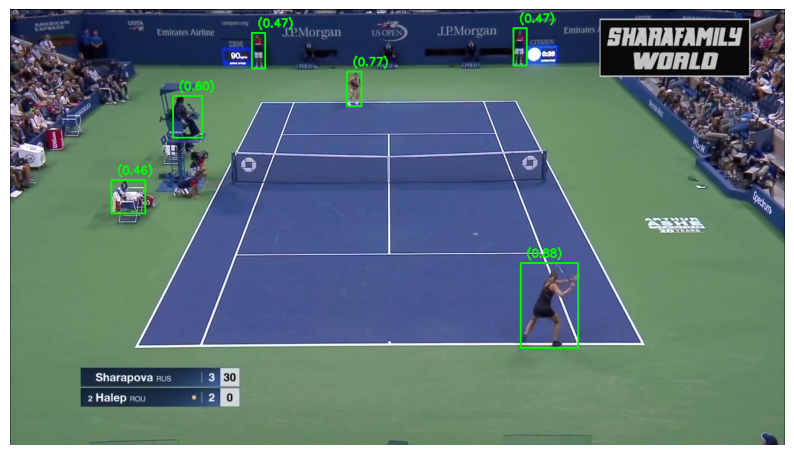


0: 384x640 5 persons, 62.4ms
Speed: 1.7ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


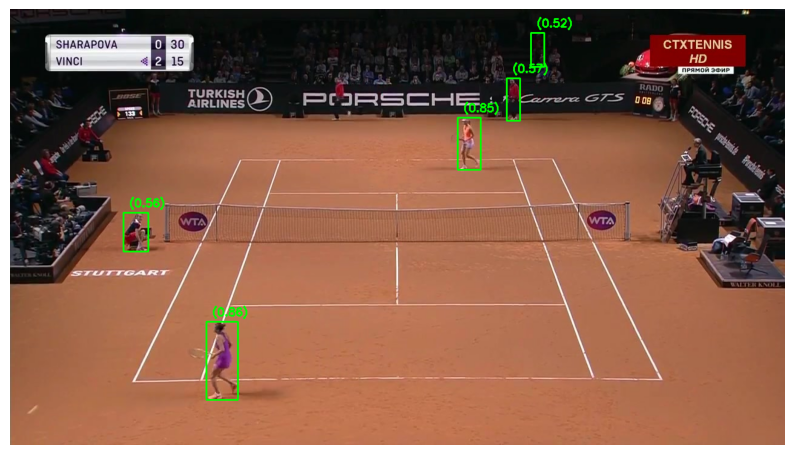


0: 384x640 7 persons, 62.4ms
Speed: 1.9ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


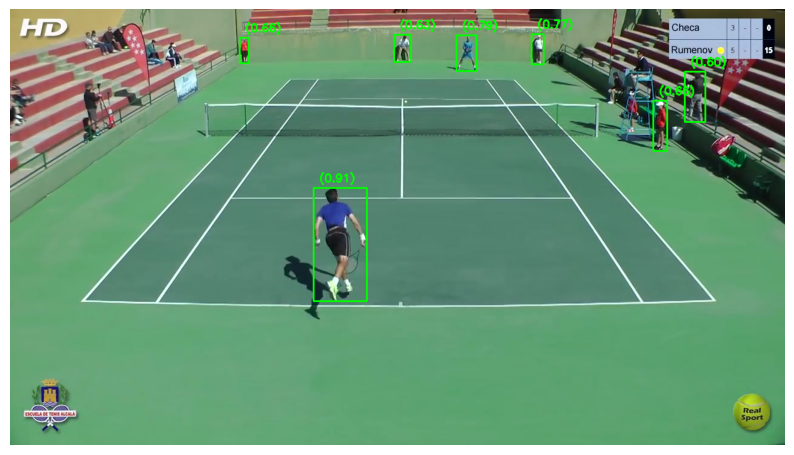


0: 384x640 4 persons, 62.4ms
Speed: 1.7ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


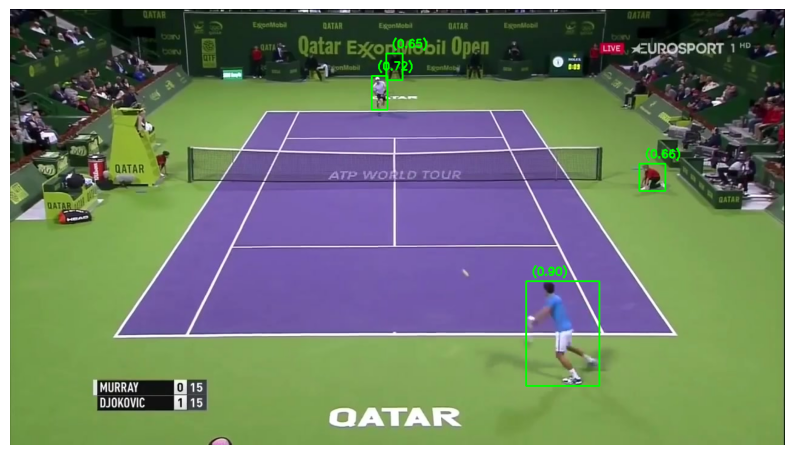


0: 384x640 6 persons, 62.4ms
Speed: 1.9ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


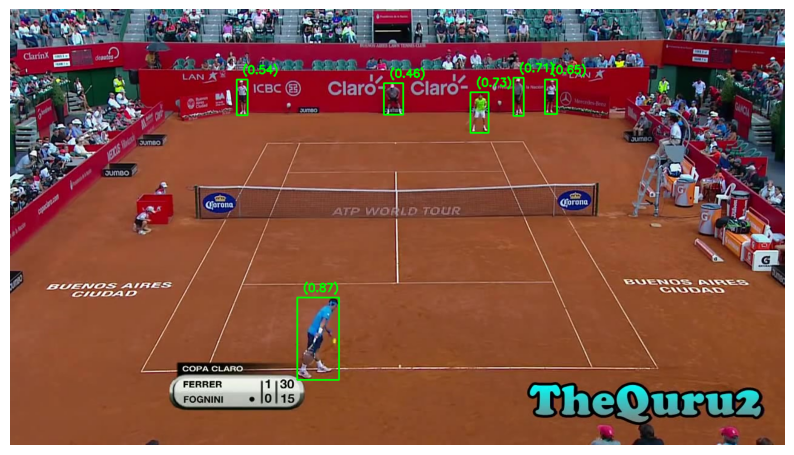

In [ ]:
for img_path in frames:
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    predicciones = modelo(img_rgb, conf=0.4, classes=[0])

    img_out = img.copy()

    for r in predicciones:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            persona = {
                "bbox": [x1, y1, x2, y2],
                "conf": conf
            }

            img_out = dibuja_bbox(
                img_out,
                persona,
                label="",
                color=(0, 255, 0)
            )

    mostrar_imagen(img_out)


Los resultados nos permiten observar el rendimiento del detector y evidencian que es capaz de **detectar correctamente a los jugadores principales** en la mayoría de los casos (puede fallar si la postura del jugador se ve distorsionada o es muy rara). No obstante, también se observa la **detección de otras personas** presentes en la escena, como recogepelotas, jueces de línea o miembros del público cercanos a la pista, lo que es **fundamental tenerlo en cuenta** ya que indica la **necesidad de incorporar mecanismos adicionales de selección y filtrado** en las etapas siguientes del notebook con el fin de **identificar únicamente a los jugadores relevantes** para el análisis.


## **TÉCNICAS DE FILTRADO PARA SELECCIONAR JUGADORES**

En este apartado del notebook se describen y analizan **distintas técnicas de filtrado** empleadas para la **selección única y automática de los dos tenistas** que participan en el partido con el objetivo de quedarnos con aquella que sea **más óptima**.



### **ROI**

Como primera aproximación al problema principal en la detección de jugadores con **YOLO**, se ha empleado y evaluado una técnica **totalmente manual** basada en **regiones de interés (ROI)**.

El objetivo principal de esta estrategia es **restringir el espacio de búsqueda** de las detecciones, de manera que **únicamente se consideren** aquellas **personas que se encuentren dentro** de la zona predefinida en la imagen.

No obstante, esta técnica presenta **limitaciones importantes**. En primer lugar, su **efectividad** va a depender de la **posición y orientación de la cámara**, ya que una ROI definida para un determinado punto de vista **puede dejar de ser válida en otros clips**, lo que verificaremos posteriormente. Además, pueden haber situaciones en las que elementos ajenos al juego, como recogepelotas, pueden aparecer dentro de la región de interés, mientras que uno de los jugadores puede quedar parcialmente fuera de ella, provocando **falsos positivos o pérdidas de detección**. Además, al ser una técnica **estática**, es **incapaz** de adaptarse dinámicamente a cambios en la escena, por ejemplo, el movimiento de los jugadores hacia las esquinas de la pista.


Por tanto, **no es una solución robusta** para generalizar a los distintos clips, por lo que posteriormente se van a evaluar nuevas técnicas de filtrado.



In [ ]:
# funcion que resume el pipeline completo para:
# * detectar personas con yolo
# * filtrado con ROI generico
# * seleccion de jugador superior e inferior

def pipeline_yolo_roi_jugadores(img, modelo, roi, draw_debug=True):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_out = img.copy()

    # se obtienen las predicciones realizadas por yolo para la detección de personas
    # (classes[0])
    predicciones = modelo(img_rgb, conf=0.4, verbose=False, classes=[0])

    bboxes = []
    for r in predicciones:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            persona = {
                "bbox": [x1, y1, x2, y2],
                "conf": conf
            }

            # se almacenan las personas detectadas
            bboxes.append(persona)

            if draw_debug:
                img_out = dibuja_bbox(
                    img_out,
                    persona,
                    label="",
                    color=(0, 255, 0)
                )

    # detecciones YOLO
    if draw_debug:
        plt.figure(figsize=(10, 6))
        plt.imshow(cv2.cvtColor(img_out, cv2.COLOR_BGR2RGB))
        plt.title("Detecciones Personas YOLO")
        plt.axis("off")
        plt.show()

    # visualizacion de roi
    if draw_debug:
        img_roi = img.copy()
        cv2.polylines(
            img_roi,
            [roi],
            isClosed=True,
            color=(0, 255, 255),
            thickness=2
        )

        plt.figure(figsize=(10, 5))
        plt.imshow(cv2.cvtColor(img_roi, cv2.COLOR_BGR2RGB))
        plt.title("ROI trapezoidal para jugadores")
        plt.axis("off")
        plt.show()

    # se recogen las personas filtradas por roi
    players_roi = []
    for p in bboxes:
        cx, cy = bbox_center(p["bbox"])
        centro = (cx, cy)

        if personas_dentro_roi(centro, roi):
            p["cx"] = cx
            p["cy"] = cy
            players_roi.append(p)

    if len(players_roi) < 2:
      return None, None

    # separacion top/bottom
    top_player, bottom_player = separar_top_bottom(players_roi)

    # bbox de los jugadores detectados
    if draw_debug:
      img_out = img.copy()
      img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

      mostrar_imagen(img_out)

    return top_player, bottom_player


# funcion que resume el pipeline completo para:
# * detectar personas con yolo
# * filtrado con ROI generico
# * seleccion de jugador superior e inferior

def _pipeline_yolo_roi_jugadores(img, modelo, roi, draw_debug=False):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_out = img.copy()

    # se obtienen las predicciones realizadas por yolo para la detección de personas
    # (classes[0])
    predicciones = modelo(img_rgb, conf=0.4, classes=[0], verbose=False)

    bboxes = []
    for r in predicciones:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            persona = {
                "bbox": [x1, y1, x2, y2],
                "conf": conf
            }

            # se almacenan las personas detectadas
            bboxes.append(persona)

            if draw_debug:
                img_out = dibuja_bbox(
                    img_out,
                    persona,
                    label="",
                    color=(0, 255, 0)
                )

    # detecciones YOLO
    if draw_debug:
        plt.figure(figsize=(10, 6))
        plt.imshow(cv2.cvtColor(img_out, cv2.COLOR_BGR2RGB))
        plt.title("Detecciones Personas YOLO")
        plt.axis("off")
        plt.show()

    # visualizacion de roi
    if draw_debug:
        img_roi = img.copy()
        cv2.polylines(
            img_roi,
            [roi],
            isClosed=True,
            color=(0, 255, 255),
            thickness=2
        )

        plt.figure(figsize=(10, 5))
        plt.imshow(cv2.cvtColor(img_roi, cv2.COLOR_BGR2RGB))
        plt.title("ROI trapezoidal para jugadores")
        plt.axis("off")
        plt.show()

    # filtrado por roi
    players_roi = []
    for p in bboxes:
        cx, cy = bbox_center(p["bbox"])
        centro = (cx, cy)

        if personas_dentro_roi(centro, roi):
            p["cx"] = cx
            p["cy"] = cy
            players_roi.append(p)

    # ningun jugador detectado
    if len(players_roi) == 0:
      return None, None

    # un solo jugador detectado
    if len(players_roi) == 1:
        player = players_roi[0]
        # decidimos si es top o bottom según su posición vertical
        if player["cy"] < img.shape[0] / 2:
            return player, None
        else:
            return None, player

    # separacion top/bottom (dos o mas jugadores)
    top_player, bottom_player = separar_top_bottom(players_roi)

    # bbox de los jugadores detectados
    if draw_debug:
      img_out = img.copy()
      img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

      mostrar_imagen(img_out)

    return top_player, bottom_player

#### **ROI APLICADO SOBRE UN ÚNICO FRAME**

Para verificar lo dicho teóricamente en la práctica, se parte de un frame aleatorio y se construye una ROI para este.

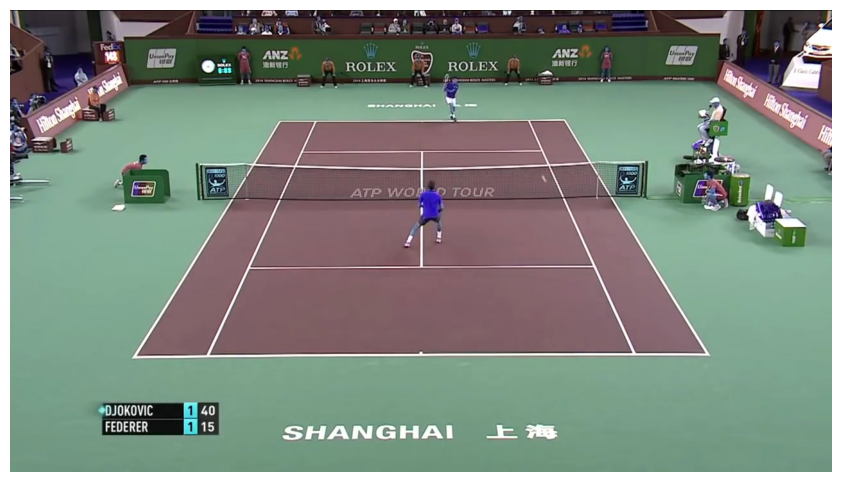

In [ ]:
frames = frames_aleatorios(DATASET_DIR, num_games=1)
img = cv2.imread(frames[0])
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

mostrar_imagen(img_rgb)

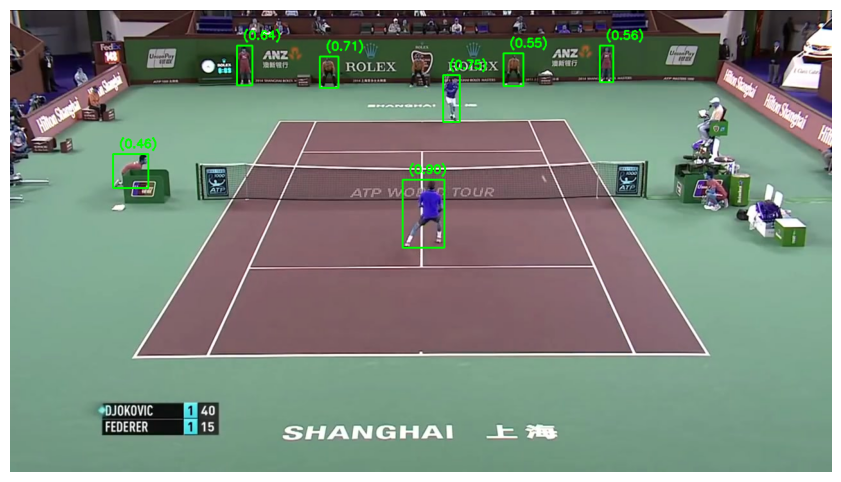

In [ ]:
# se obtienen las predicciones realizadas por yolo para la detección de personas
# (classes[0])
predicciones = modelo(img_rgb, conf=0.4, classes=[0])

img_out = img.copy()

# lista para almacenar informacion de cada una de las personas detectadas
bboxes = []
for p in predicciones:
    for bbox in p.boxes:
        x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
        conf = float(bbox.conf[0].cpu().numpy())

        persona = {
            "bbox": [x1, y1, x2, y2],
            "conf": conf
        }

        bboxes.append(persona)

        img_out = dibuja_bbox(
            img_rgb,
            persona,
            label="",
            color=(0, 255, 0)
        )

mostrar_imagen(img_out)

La **región de interés** se define con **forma trapezoidal**, en lugar de rectangular, con el objetivo de **adaptarse** mejor a la proyección en perspectiva de la pista de tenis en la mayoría de los clips del dataset, donde las líneas de la pista **convergen hacia la parte superior** de la imagen, provocando que la zona jugable presente una **anchura menor en la parte superior y mayor en la inferior**.

Para definir los **vértices del trapezoide**, se toman **proporciones relativas del ancho y alto de la imagen**, en lugar de coordenadas absolutas

```python3
H, W = img.shape[:2]
```
lo que consigue que la ROI sea **más generalizable**.


In [ ]:
# nos quedamos con el ancho y alto de la imagen
H, W = img.shape[:2]

# ROI trapezoidal para quedarnos solamente con los jugadores
# con esto evitamos capturar los recogepelotas y los jueces
roi = np.array([
    [int(0.25 * W), int(0.14 * H)],  # arriba izquierda
    [int(0.75 * W), int(0.14 * H)],  # arriba derecha
    [int(0.95 * W), int(0.95 * H)],  # abajo derecha (más ancho)
    [int(0.05 * W), int(0.95 * H)],  # abajo izquierda (más ancho)
], dtype=np.int32)

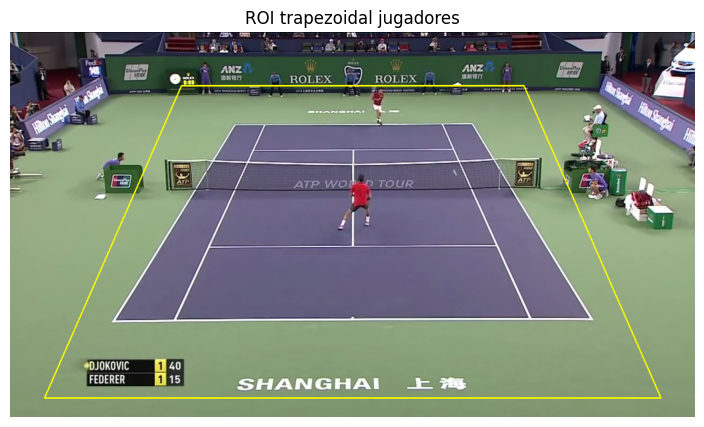

In [ ]:
img_roi = img.copy()

cv2.polylines(
    img_roi,
    [roi],
    isClosed=True,
    color=(0, 255, 255),
    thickness=2
)

plt.figure(figsize=(10,5))
plt.imshow(cv2.cvtColor(img_roi, cv2.COLOR_BGR2RGB))
plt.title("ROI trapezoidal jugadores")
plt.axis("off")
plt.show()

Para determinar qué **personas** se encuentran dentro de la región **ROI**, y que por tanto, deberían ser **tenistas**, se calcula el **centro geométrico de las bounding boxes** previamente obtenidas mediante **YOLO** como punto representativo de la **posición de la persona** en la imagen, ya que es una **aproximación estable** de dónde se encuentra la persona.

Posteriormente, se comprueba si dicho punto se encuentra dentro del trapezoide que define la **ROI** mediante `cv2.pointPolygonTest`, **reduciendo** significativamente el **número de falsas detecciones**.

In [ ]:
# función que determina si el centro de la bounding box que representa
# una persona (tenista) está dentro del trapezoide descrito por ROI.

# si estas dentro, se detecta
# si no, no se detecta.

def personas_dentro_roi(centro_bbox, roi):
    return cv2.pointPolygonTest(
        np.array(roi, dtype=np.int32),
        centro_bbox,
        False
    ) >= 0


In [ ]:
# almacena las personas dentro de ROI
players_roi = []

for p in bboxes:
    # se calcula el centro de la bbox de cada jugador(x, y)
    cx, cy = bbox_center(p["bbox"])
    centro = (cx, cy)

    # comprobar si está dentro del ROI
    if personas_dentro_roi(centro, roi):
        p["cx"] = cx
        p["cy"] = cy
        players_roi.append(p)

##### **SEPARACIÓN DE JUGADORES: SUPERIOR E INFERIOR**

Una vez filtradas las detecciones para quedarnos únicamente con las personas dentro de la ROI, el siguiente paso consiste en **diferenciar a los dos jugadores** del partido.

Jugando con la **proyección en perspectiva** de la cámara, al igual que hicimos a la hora de definir la región ROI, se puede ver que los **jugadores** aparecen **separados en el eje vertical de la imagen**. Por tanto, hemos aprovechado esto para **distinguir** las detecciones ya filtradas en función de la **coordenada vertical `y`** del **centro de su bounding box `cy`**.

De esta manera:

* El **jugador con menor valor** de `cy` corresponde al **jugador superior** (más alejado de la cámara).
*	El **jugador con mayor valor** de `cy` corresponde al **jugador inferior** (más cercano a la cámara).

Obviamente, este criterio es sólamente óptimo cuando únicamente se tienen **dos detecciones válidas** tras el filtrado por ROI, presentando **limitaciones** si solo se detecta un jugador o la cámara no sigue una disposición vertical realmente clara.



In [ ]:
for p in players_roi:
  print(p)

{'bbox': [np.float32(611.66113), np.float32(264.2682), np.float32(676.4343), np.float32(370.667)], 'conf': 0.8957489132881165, 'cx': np.float32(644.0477), 'cy': np.float32(317.4676)}
{'bbox': [np.float32(674.1677), np.float32(101.1422), np.float32(700.2623), np.float32(174.35918)], 'conf': 0.7453357577323914, 'cx': np.float32(687.215), 'cy': np.float32(137.75069)}


In [ ]:
# separacion top/bottom
top_player, bottom_player = separar_top_bottom(players_roi)

print(top_player)
print(bottom_player)

{'bbox': [np.float32(674.1677), np.float32(101.1422), np.float32(700.2623), np.float32(174.35918)], 'conf': 0.7453357577323914, 'cx': np.float32(687.215), 'cy': np.float32(137.75069)}
{'bbox': [np.float32(611.66113), np.float32(264.2682), np.float32(676.4343), np.float32(370.667)], 'conf': 0.8957489132881165, 'cx': np.float32(644.0477), 'cy': np.float32(317.4676)}


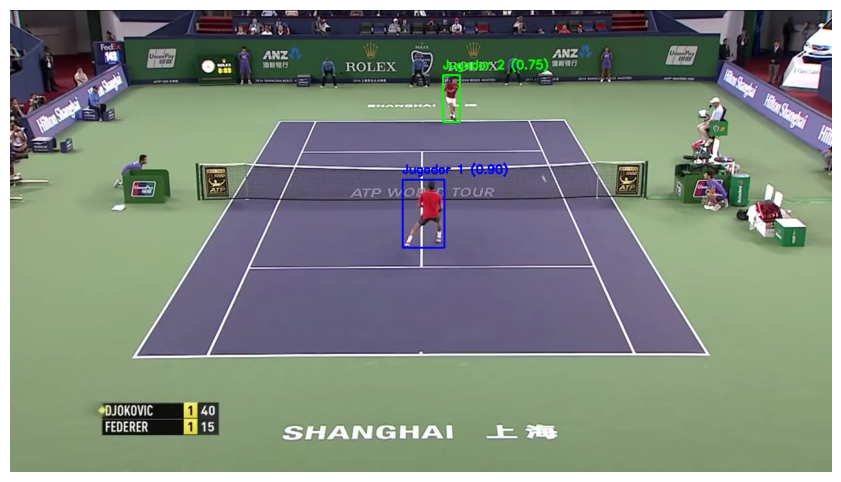

In [ ]:
# se dibujan las bbox
img_out = dibuja_bbox_jugadores(img, top_player, bottom_player)
mostrar_imagen(img_out)

#### **ROI APLICADO SOBRE DISTINTOS FRAMES**

Para evaluar el comportamiento real de **ROI** como técnica de filtrado, se ha aplicado sobre distintos frames del dataset utilizando el mismo trapezoide definido previamente. Como era de esperar, los resultados obtenidos son totalmente coherentes con las suposiciones teóricas mencionadas anteriormente, confirmando las **limitaciones de este enfoque**.

Aunque **ROI** funciona **correctamente en un conjunto reducido de frames** (2 frames de la batería experimental=, es **incapaz de generalizar**. En particular, se observan distintos casos de error. Por un lado, cuando el trapezoide es **excesivamente ancho en la parte superior**, recoge **tanto al jugador superior como a los recogepelotas situados detrás**, que al tener una coordenada `cy` menor, son **seleccionados erróneamente como tenistas** según el criterio de ordenación empleado. Por otro lado, se aprecia el caso inverso, donde la **parte superior del ROI es tan estrecha** que **no logra recoger al jugador superior**, provocando que únicamente se detecte al jugador inferior.


0: 384x640 10 persons, 62.5ms
Speed: 1.9ms preprocess, 62.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


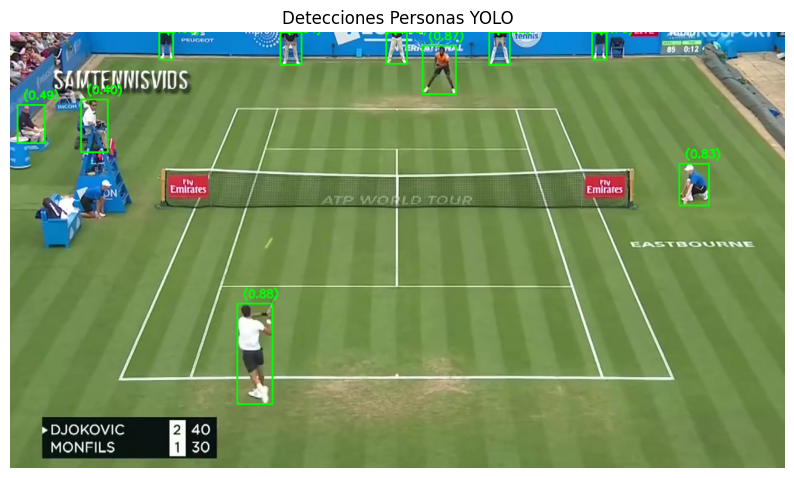

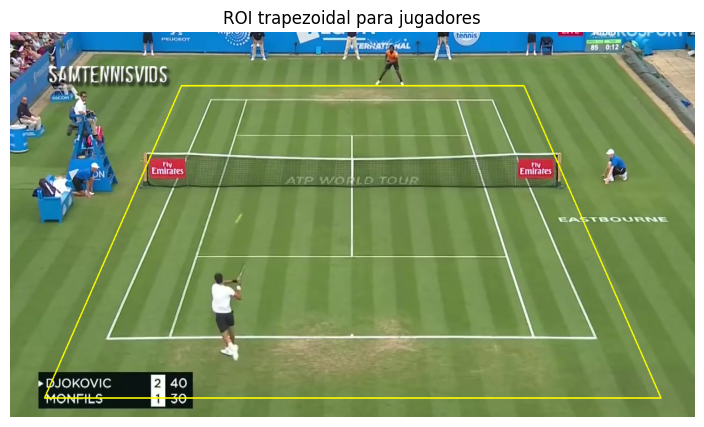

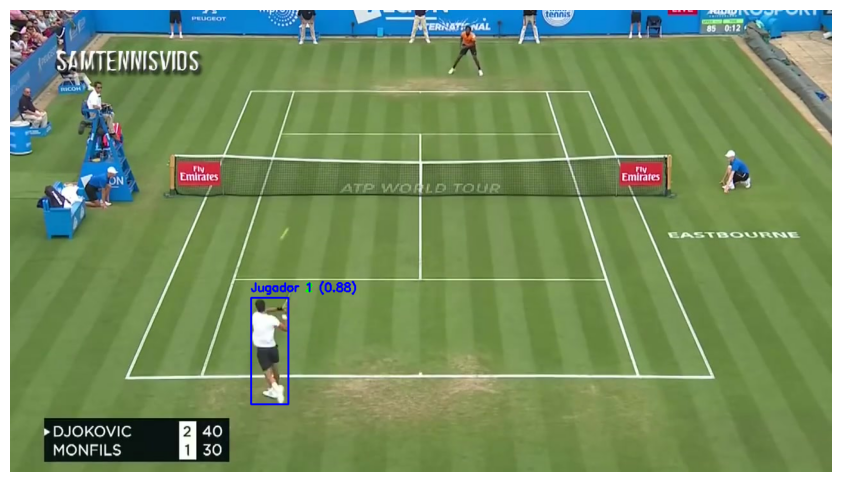


0: 384x640 4 persons, 62.4ms
Speed: 1.9ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


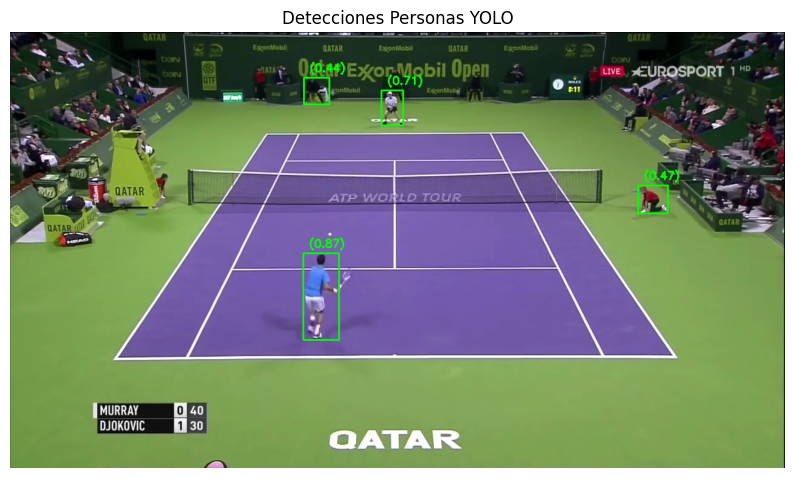

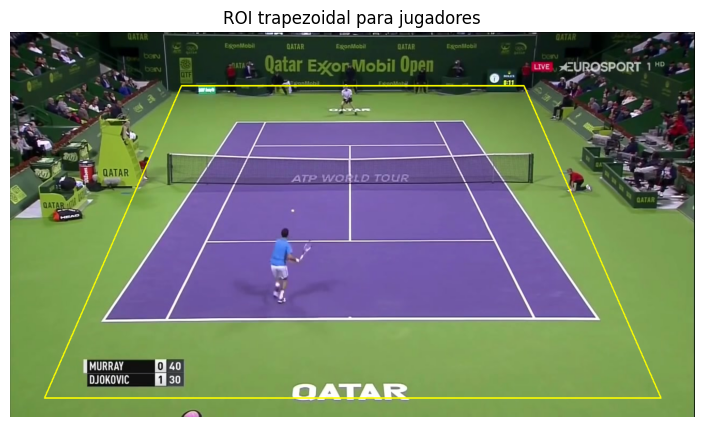

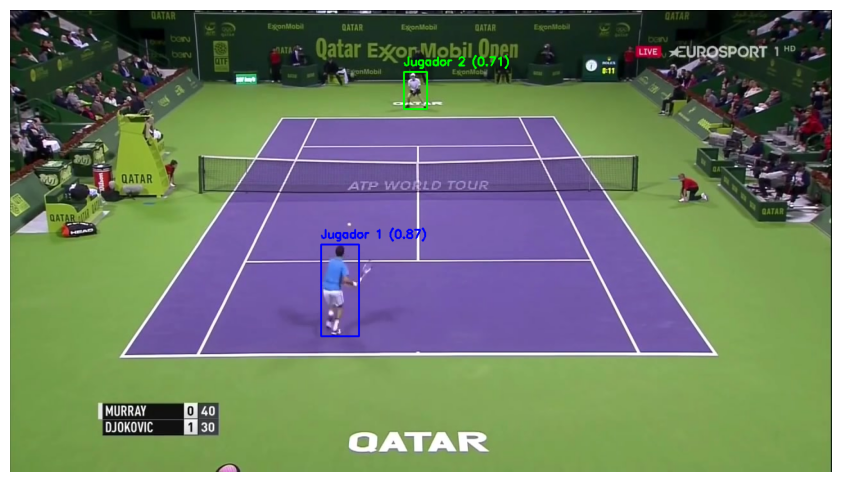


0: 384x640 9 persons, 62.4ms
Speed: 1.8ms preprocess, 62.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


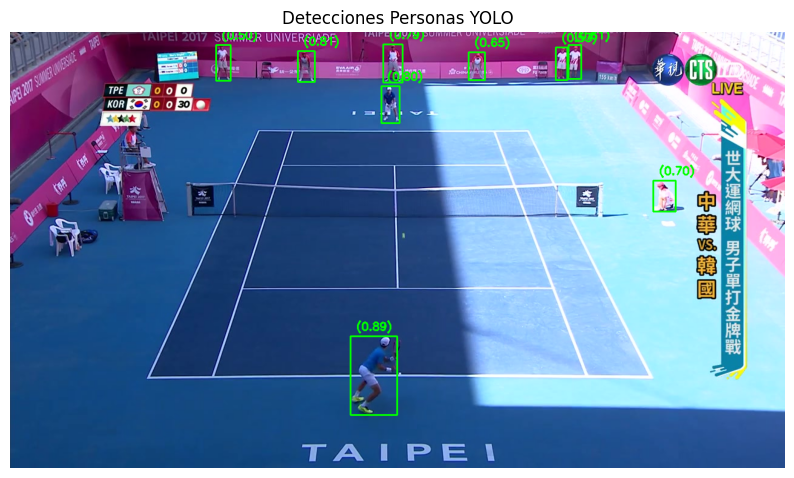

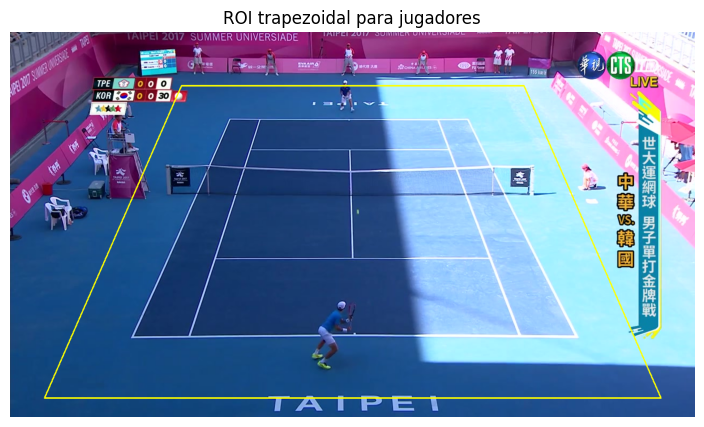

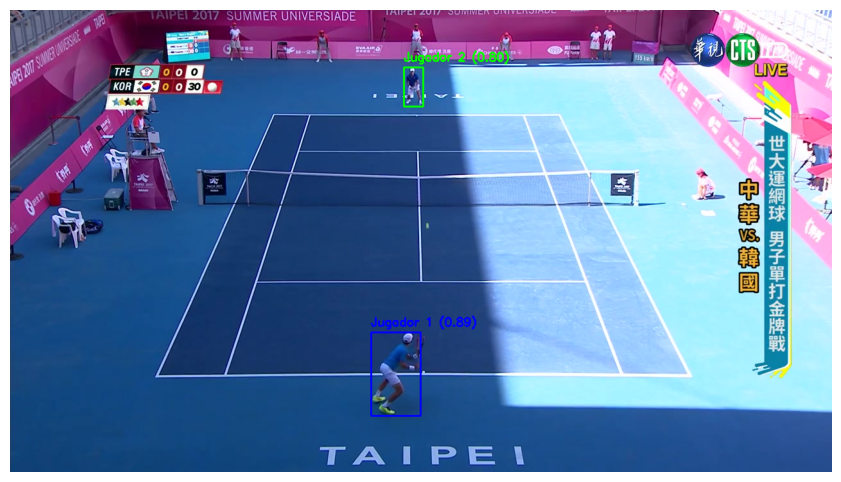


0: 384x640 5 persons, 62.4ms
Speed: 2.0ms preprocess, 62.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


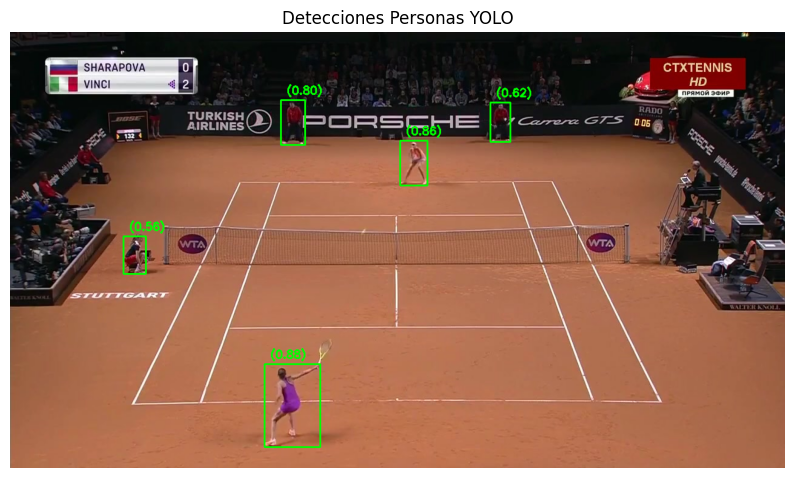

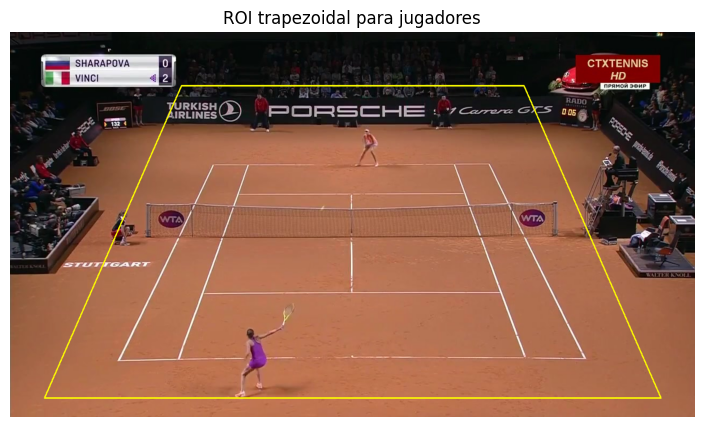

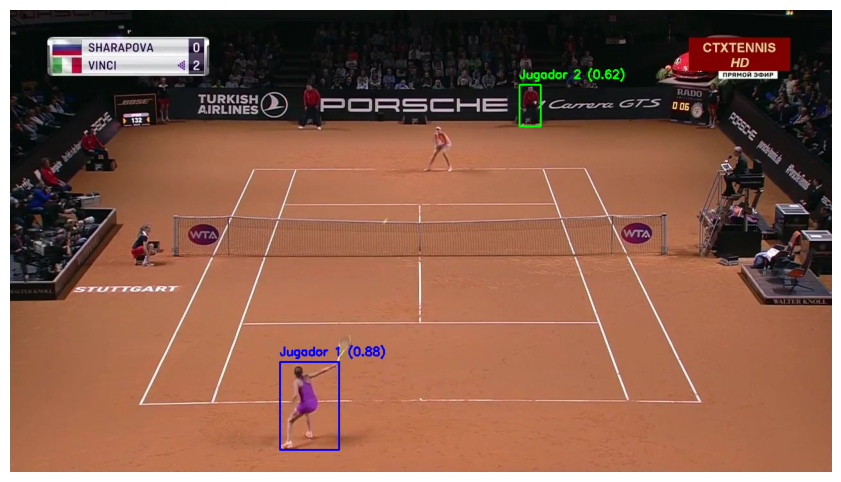


0: 384x640 10 persons, 62.4ms
Speed: 2.1ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


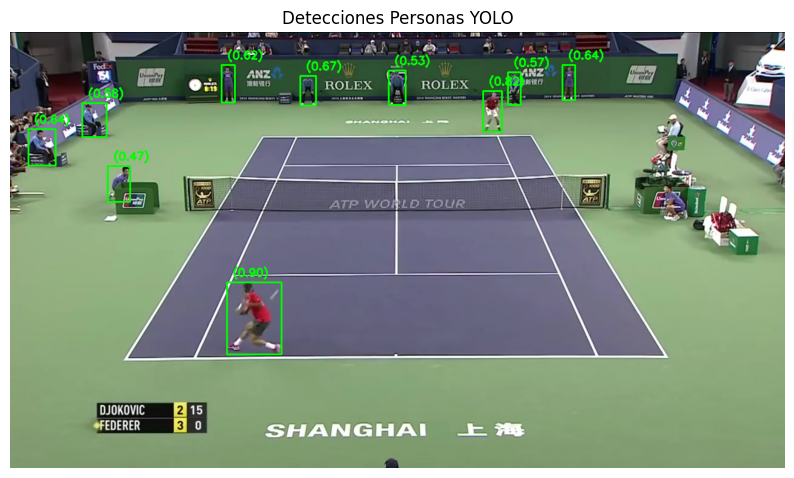

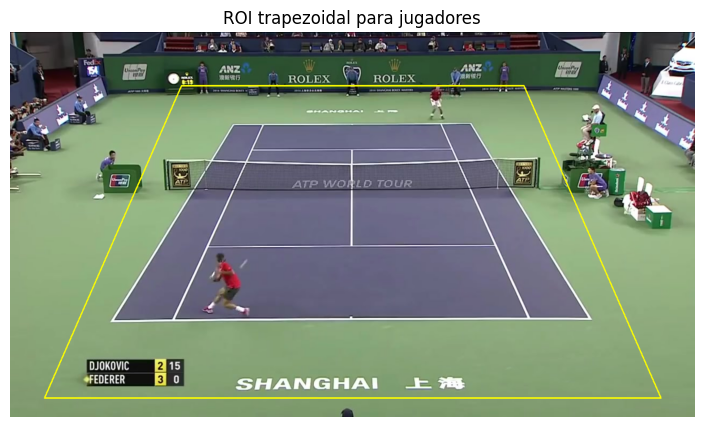

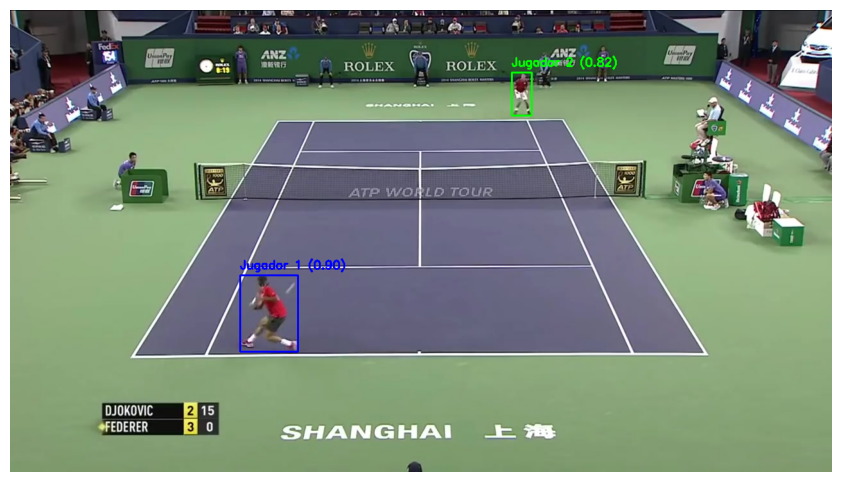

In [ ]:
frames = frames_aleatorios(DATASET_DIR, num_games=5)

for img_path in frames:
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    _, _ = pipeline_yolo_roi_jugadores(img, modelo, roi)

#### **ROI APLICADO SOBRE DISTINTOS VIDEOS**

Tras haber comprobado las **limitaciones** de **ROI** como técnica de filtrado, se procede a aplicar esta técnica sobre una **secuencia completa de imágenes (clips)**, generando un video que permita evaluar su comportamiento de forma **temporal y continua**.

De esta manera, para cada frame del clip se ejecuta el pipeline de detección definido, obteniendo, cuando es posible, la identificación del **jugador superior** y del **jugador inferior**. Además, se dibuja de forma **constante** el **trapezoide ROI** sobre cada frame con el objetivo de visualizar la región empleada como criterio de filtrado.

Además, se dibujan únicamente los **bounding boxes** de los jugadores **cuando ambos han sido detectados correctamente en el mismo frame**, evitando así visualizaciones inconsistentes que realmente representan un **mal comportamiento**.

In [ ]:
fps = 30

img_dir = "data/tracknet/Dataset/game7/Clip2"
img_paths = sorted(glob.glob(img_dir + "/*.jpg"))

out_path = "players_tracking_roi.mp4"
fourcc = cv2.VideoWriter_fourcc(*"mp4v")
video_writer = cv2.VideoWriter(out_path, fourcc, fps, (W, H))

for frame_idx, img_path in enumerate(img_paths):
    img = cv2.imread(img_path)

    # se ejecuta el pipeline con filtrado de ROI para detectar a los supuestos
    # top y bottom player
    top_player, bottom_player = pipeline_yolo_roi_jugadores(
        img,
        modelo,
        roi,
        draw_debug=False
    )

    img_out = img.copy()

    # se dibuja ROI
    cv2.polylines(
        img_out,
        [roi],
        isClosed=True,
        color=(0, 255, 255),
        thickness=2
    )

    # si no se detectan correctamente ambos jugadores
    if top_player is None or bottom_player is None:
        video_writer.write(img_out)
        continue

    img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    video_writer.write(img_out)

video_writer.release()
print("Vídeo generado:", out_path)

!ffmpeg -y -i players_tracking_roi.mp4 -vcodec libx264 -pix_fmt yuv420p players_tracking_roi_fix.mp4 > /dev/null 2>&1

Vídeo generado: players_tracking_roi.mp4


En este primer video, se puede observar cómo, debido a la **configuración del ROI**, el **jugador superior no llega a ser detectado en ningún frame** del clip, y por tanto, **las bounding boxes no se representan** aun cuando el jugador inferior sí es correctamente detectado por el modelo.


In [ ]:
display(Video("players_tracking_roi_fix.mp4", embed=True))

In [ ]:
fps = 30

img_dir = "data/tracknet/Dataset/game2/Clip2"
img_paths = sorted(glob.glob(img_dir + "/*.jpg"))

out_path = "players_tracking_roi_2.mp4"
fourcc = cv2.VideoWriter_fourcc(*"mp4v")
video_writer = cv2.VideoWriter(out_path, fourcc, fps, (W, H))

for frame_idx, img_path in enumerate(img_paths):
    img = cv2.imread(img_path)

    # se ejecuta el pipeline con filtrado de ROI para detectar a los supuestos
    # top y bottom player
    top_player, bottom_player = pipeline_yolo_roi_jugadores(
        img,
        modelo,
        roi,
        draw_debug=False
    )

    img_out = img.copy()

    # lineas de roi
    cv2.polylines(
        img_out,
        [roi],
        isClosed=True,
        color=(0, 255, 255),
        thickness=2
    )

    # si no se detectan correctamente ambos jugadores
    if top_player is None or bottom_player is None:
        video_writer.write(img_out)
        continue

    img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)
    video_writer.write(img_out)

video_writer.release()
print("Vídeo generado:", out_path)

!ffmpeg -y -i players_tracking_roi_2.mp4 -vcodec libx264 -pix_fmt yuv420p players_tracking_roi_2_fix.mp4 > /dev/null 2>&1

Vídeo generado: players_tracking_roi_2.mp4


En este caso, se aprecia un comportamiento **inconsistente** en la detección del **jugador superior**, aunque algo más correcto que en el caso anterior, donde, en algunos frames, el jugador es correctamente identificado y su bounding box es dibujada junto a la del jugador inferior; sin embargo, en otros frames, **parte de su cuerpo queda fuera del ROI** y deja de ser considerado como tenista válido.

In [ ]:
display(Video("players_tracking_roi_2_fix.mp4", embed=True))

Una vez más, la causa principal de este problema vuelve a estar relacionado con la **mala generalización de ROI**, que no se adapta dinámicamente a los cambios de posición de los jugadores ni a ligeras variaciones de la perspectiva recogida por la cámara en los distintos **games** del dataset. Como consecuencia, ocurre lo que hemos visto en los distintos ejemplos: un mismo jugador puede alternar entre estar dentro y fuera de la región de interés, a pesar de encontrarse dentro de la pista, o cercano a esta.

Además, se ha observado que este problema se aplica principalmente sobre el jugador **superior**, debido a la forma de la pista en perspectiva ya indicada previamente, que se estrecha en su parte superior, recogiendo así un menor campo de visión, y por ende, siendo menos robusta para la detección de dicho jugador, como muestran los siguientes resultados:

In [ ]:
# función de metrica para determinar numero de frames/clip donde se pierde la
# deteccion de uno o ambos jugadores

def perdida_frames_jugadores(img_paths, modelo, roi):
    total_frames = len(img_paths)

    # aux para contabilizar las perdidas
    perdida_top = 0
    perdida_bottom = 0
    perdida_ambos = 0

    for img_path in img_paths:
        img = cv2.imread(img_path)

        # se ejecuta el pipeline con filtrado de ROI para detectar a los supuestos
        # top y bottom player
        top, bottom = _pipeline_yolo_roi_jugadores(
            img, modelo, roi, draw_debug=False
        )

        # si no se detecta top ni bottom
        if top is None and bottom is None:
            perdida_ambos += 1
        elif top is None: # si no se detecta top
            perdida_top += 1
        elif bottom is None: # si no se detecta bottom
            perdida_bottom += 1

    return perdida_ambos, perdida_top, perdida_bottom


# porcentaje de frames donde se detectan correctamente ambos jugadores
def frames_correctos(img_paths, modelo, roi):
    total_frames = len(img_paths)

    # frames correctos
    frames_ok = 0

    for img_path in img_paths:
        img = cv2.imread(img_path)

        # se ejecuta el pipeline con filtrado de ROI para detectar a los supuestos
        # top y bottom player
        top, bottom = _pipeline_yolo_roi_jugadores(
            img, modelo, roi, draw_debug=False
        )

        # si ambos son detectados
        if top is not None and bottom is not None:
            frames_ok += 1

    proporcion_correctos = frames_ok / total_frames if total_frames > 0 else 0.0
    return proporcion_correctos, frames_ok, total_frames

In [ ]:
clips = clips_aleatorios(DATASET_DIR, num_games=5)
resultados = []

for clip_path in clips:
    img_paths = sorted(glob.glob(os.path.join(clip_path, "*.jpg")))

    if len(img_paths) == 0:
        continue

    # perdidas
    perdida_ambos, perdida_top, perdida_bottom = perdida_frames_jugadores(
        img_paths,
        modelo,
        roi
    )

    # porcentaje de correctos
    proporcion_correctos, frames_ok, total_frames = frames_correctos(
        img_paths,
        modelo,
        roi
    )

    resultados.append({
        "clip": clip_path,
        "total_frames": len(img_paths),
        "perdida_ambos": perdida_ambos,
        "perdida_top": perdida_top,
        "perdida_bottom": perdida_bottom,
        "proporcion_correctos": proporcion_correctos,
        "frames_ok": frames_ok,
    })

In [ ]:
for r in resultados:
    print(f"\nClip: {r['clip']}")
    print(f"Frames totales: {r['total_frames']}")
    print(f"Frames con ambos jugadores detectados: {r['frames_ok']}")
    print(f"Proporción de frames con ambos jugadores detectados: {r['proporcion_correctos']}")
    print(f"Frames sin jugadores detectados: {r['perdida_ambos']}")
    print(f"Frames sin jugador superior: {r['perdida_top']}")
    print(f"Frames sin jugador inferior: {r['perdida_bottom']}")


Clip: data/tracknet/Dataset/game1/Clip13
Frames totales: 253
Frames con ambos jugadores detectados: 251
Proporción de frames con ambos jugadores detectados: 0.9920948616600791
Frames sin jugadores detectados: 0
Frames sin jugador superior: 1
Frames sin jugador inferior: 1

Clip: data/tracknet/Dataset/game7/Clip1
Frames totales: 128
Frames con ambos jugadores detectados: 52
Proporción de frames con ambos jugadores detectados: 0.40625
Frames sin jugadores detectados: 0
Frames sin jugador superior: 76
Frames sin jugador inferior: 0

Clip: data/tracknet/Dataset/game2/Clip6
Frames totales: 551
Frames con ambos jugadores detectados: 30
Proporción de frames con ambos jugadores detectados: 0.0544464609800363
Frames sin jugadores detectados: 34
Frames sin jugador superior: 487
Frames sin jugador inferior: 0

Clip: data/tracknet/Dataset/game9/Clip4
Frames totales: 106
Frames con ambos jugadores detectados: 106
Proporción de frames con ambos jugadores detectados: 1.0
Frames sin jugadores detecta

Por tanto, esta técnica conduce a un problema de **inestabilidad temporal** en la detección, donde la identidad de los jugadores  no se mantiene de forma continua a lo largo del clip, provocando **parpadeos** en la visualización de las bounding boxes y pérdidas puntuales de información. Es por ello, por lo que **ROI** como único filtrado nos ha sido útil como primera prueba experimental, pero **no es adecuado como solución definitiva** para la selección de jugadores, especialmente cuando lo que se busca es **la mayor consistencia en la detección**.

### **ROI + INTERPOLACIÓN DE FRAMES**

Con el objetivo de **mitigar la inestabilidad temporal** introducida por el uso de **ROI**, se toma como posible **mejora experimental** la **interpolación de frames** en aquellos instantes donde uno o ambos jugadores no han sido detectados correctamente.

Tal y como se ha visto con las métricas anteriores, hay distintos **games** del dataset donde el porcentaje de frames con ambos jugadores detectados es **bastante bajo**, por lo que la motivación principal de esta técnica fue conseguir que el **movimiento de los jugadores fuese suave y continuo**, que es el objetivo de este notebook. De esta manera, se consigue **rellenar los huecos temporales** producidos por fallos puntuales del detector sin necesidad del modificar el modelo de detección.

#### **INTERPOLACIÓN LINEAL DE POSICIONES DE LOS JUGADORES**

Antes de nada, es importante tener en cuenta que **no corrige los errores de filtrado de ROI**, sino que actúa como un **mecanismo de suavizado temporal** ante las perdidas de detección. Por ello, se corresponde con una **mejora incremental** sobre ROI y no como una solución al problema de selección de jugadores, siendo su principal **limitación** el **no poder utilizarse** para reconstruir las bounding boxes generadas por **YOLO**, puesto que estas también varían su tamaño en función de la **posición y escala en la que se encuentra el jugador**.

Dicho esto, para estimar la posición de los jugadores en aquellos frames donde no han sido detectados correctamente se ha considerado que el movimiento de un jugador entre dos frames consecutivos es **continuo** dado el número elevado de frames por clip. De esta manera, la posición del jugador en un frame intermedio se va a poder **aproximar a partir de las detecciones que sí son válidas más cercanas en el tiempo**, consiguiendo reducir en parte el **parpadeo visual** de las bounding boxes.

Matemáticamente, y dado que para su implementación se utiliza la función `np.interp`, que opera sobre vectores unidimensionales 1D, la interpolación se realiza **por separado** para las coordenadas del **centro de la bounding box** $c_x$ e $c_y$:

$$c_x(t) = c_x(t_1) + \frac{t - t_1}{t_2 - t_1} \left( c_x(t_2) - c_x(t_1) \right)$$

$$c_y(t) = c_y(t_1) + \frac{t - t_1}{t_2 - t_1} \left( c_y(t_2) - c_y(t_1) \right)$$

donde $t$ es el **índice de frame**, y el vector $\mathbf{p}(t) = (c_x(t), c_y(t))$ define la **posición estimada del jugador** en dicho frame, en concreto, las coordenadas de los **centros de las bounding boxes** de cada jugador:

$$c_x = \frac{x_1 + x_2}{2}, \quad
c_y = \frac{y_1 + y_2}{2}$$

siendo $(x_1, y_1)$ y $(x_2, y_2)$ las esquinas superior izquierda e inferior derecha de la bounding box detectada por **YOLO**.

De este modo, solamente se consideran las detecciones válidas, es decir, aquellas donde la **posición es conocida en dos instantes** $t_1$ y $t_2$, con $t_1 < t < t_2$. En caso contrario, la interpolación **se descarta** al no existir información suficiente para estimar el movimiento.

Finalmente, las coordenadas interpoladas $c_x(t)$ y $c_y(t)$ se **recombinan** para obtener la posición estimada del jugador en cada frame, logrando así una **trayectoria continua** incluso si hay pérdidas puntuales de detección.

In [ ]:
# rellena las posiciones del jugador en los frames donde no fue detectado utilizando
# las detecciones validas de frames cercanos

def interpola_posiciones(datos_trackeo, jugador):
    # jugador = "top_player" o "bottom_player"

    frames = [] # lista con los índices de frame
    posiciones = [] # lista de posiciones (cx, cy) o (nan, nan) si no se detecta

    for d in datos_trackeo:
        frames.append(d["frame_idx"])

        if d[jugador] is not None:
            posiciones.append(d[jugador])
        else:
            posiciones.append((np.nan, np.nan))

    # convertimos a arrays
    frames = np.array(frames)
    posiciones = np.array(posiciones)

    # necesario ya que np.interp utiliza vectores 1d, no 2d (cx, cy)
    x = posiciones[:, 0] # separamos las coordenadas quedandonos con todos los cxs
    y = posiciones[:, 1] # separamos las coordenadas quedandonos con todos los cys

    # interpolamos linealmente ignorando los nones
    valid = ~np.isnan(x)

    # si por algún motivo no hay detecciones válidas, abortamos
    if valid.sum() < 2:
        raise ValueError(f"No hay suficientes detecciones válidas para interpolar '{jugador}'")

    x_interp = np.interp(frames, frames[valid], x[valid])
    y_interp = np.interp(frames, frames[valid], y[valid])

    # se vuelven a unir los pares de coordenadas ya interpolados
    posiciones_interpoladas = []
    for i in range(len(x_interp)):
        posiciones_interpoladas.append((x_interp[i], y_interp[i]))

    return posiciones_interpoladas

Visualmente, la gráfica generada muestra conceptualmente el efecto de la interpolación lineal mediante `np.interp` aplicada sobre la coordenada `cy`, que simula la coordenada **vertical** del centro de las bounding box de un jugador.

En ella, los puntos **negros** representan **detecciones válidas** obtenidas por YOLO tras aplicar ROI, mientras que los **puntos azules** corresponden a frames donde la **detección falla** y la posición se estima mediante **interpolación lineal** a partir de detecciones válidas cercanas, tal y como se dijo.

De esta forma, se puede ver como esta aproximación permite **reconstruir una trayectoria "continua" del jugador**, aunque no corrige los errores de detección.

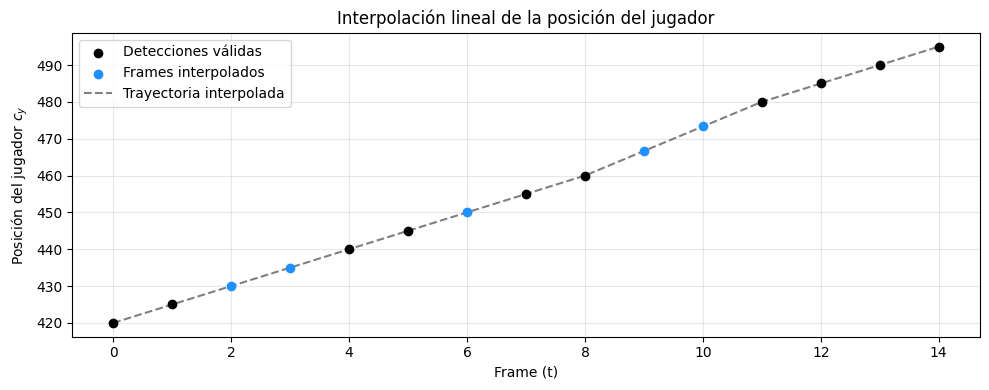

In [ ]:
# simulacion de frames
frames = np.arange(0, 15)

# posiciones reales detectadas (None = no detección)
cy_detectadas = np.array([
    420, 425, np.nan, np.nan, 440,
    445, np.nan, 455, 460, np.nan,
    np.nan, 480, 485, 490, 495
], dtype=float)

# frames válidos
valid = ~np.isnan(cy_detectadas)

# interpolacion lineal
cy_interp = np.interp(frames, frames[valid], cy_detectadas[valid])

plt.figure(figsize=(10, 4))
plt.scatter(
    frames[valid],
    cy_detectadas[valid],
    color="black",
    label="Detecciones válidas",
    zorder=3
)
plt.scatter(
    frames[~valid],
    cy_interp[~valid],
    color="dodgerblue",
    label="Frames interpolados",
    zorder=3
)
plt.plot(
    frames,
    cy_interp,
    linestyle="--",
    color="gray",
    label="Trayectoria interpolada"
)

plt.xlabel("Frame (t)")
plt.ylabel(r"Posición del jugador $c_y$")
plt.title("Interpolación lineal de la posición del jugador")
plt.legend()
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

#### **ROI vs ROI + INTERPOLACIÓN**

Aplicamos directamente la detección de jugadores sobre los videos para visualizar las diferencias presentes entre utilizar o no la **interpolación lineal** como **mejora incremental**.

##### **ROI**

In [ ]:
display(Video("players_tracking_roi__fix.mp4", embed=True))

##### **ROI + INTERPOLACIÓN DE FRAMES**

A diferencia del pipeline anterior para **ROI**, donde cada frame se procesaba de forma independiente, la interpolación requiere **información temporal**, en concreto, los **centros de las bounding boxes**, aunque se podrían haber utilizado otras coordenadas que también fuesen representativas.

Para ello, se define `datos_trackeo`, que almacena información frame a frame, y `frame_info`, que es un diccionario asociado a cada frame que guarda:
* **frame_idx**: índice del frame
* **(cx, cy)**: posición del ugador superior e inferior
* **bounding boxes** detectadas por YOLO



En esta primera celda de código, se ejecuta el **mismo pipeline** que con **ROI**, pero se almacena, para cada jugador detectado en cada frame, la información mencionada anteriormente.

Si en un frame el jugador **no es detectado**, su posición se almacena como `None`, de manera que `datos_trackeo` contiene una **secuencia temporal completa**, incluyendo **detecciones válidas y pérdidas**.

In [ ]:
img_dir = "data/tracknet/Dataset/game2/Clip2"
img_paths = sorted(glob.glob(img_dir + "/*.jpg"))

In [ ]:
# lista donde vamos a guardar la info del top/bottom player en cada frame
datos_trackeo = []

for frame_idx, img_path in enumerate(img_paths):
    img = cv2.imread(img_path)

    # se ejecuta el pipeline con filtrado de ROI para detectar a los supuestos
    # top y bottom player
    top_player, bottom_player = pipeline_yolo_roi_jugadores(
        img,
        modelo,
        roi,
        draw_debug=False
    )

    frame_info = {
        "frame_idx": frame_idx,
        "top_player": None,
        "bottom_player": None,
        "top_bbox": None,
        "bottom_bbox": None
    }

    # almacena:
    # numero de frame, (cx_top, cy_top), (cx_bottom, cy_bottom), bbox_top, bbox_bottom
    # si en un frame no detecta al jugador -> none (es lo que nos interesa saber)

    if top_player is not None:
        frame_info["top_player"] = (top_player["cx"], top_player["cy"])
        frame_info["top_bbox"] = top_player["bbox"]

    if bottom_player is not None:
        frame_info["bottom_player"] = (bottom_player["cx"], bottom_player["cy"])
        frame_info["bottom_bbox"] = bottom_player["bbox"]

    datos_trackeo.append(frame_info)

Una recopilada la información de todo el clip, se aplica la **interpolación lineal** de forma independiente para cada jugador mediante `interpola_posiciones()`, utilizando únicamente las posiciones válidas almacenadas.

In [ ]:
top_interp = interpola_posiciones(datos_trackeo, "top_player")
bottom_interp = interpola_posiciones(datos_trackeo, "bottom_player")

Finalmente, se genera el video final donde mostramos el **ROI trapezoidal**, los **puntos interpolados** de ambos jugadores en cada frame, y las **bboxes**, dibujadas únicamente en aquellos frames donde YOLO detectó al jugador, evitando, como se dijo anteriormente, reconstrucciones artificiales del tamaño de la caja.

In [ ]:
out_path = "players_tracking_roi_interpolacion.mp4"
video_writer = cv2.VideoWriter(out_path, fourcc, fps, (W, H))

for frame_idx, img_path in enumerate(img_paths):
    img = cv2.imread(img_path)
    img_out = img.copy()

    # se dibuja roi
    cv2.polylines(
        img_out,
        [roi],
        isClosed=True,
        color=(0, 255, 255),  # amarillo
        thickness=2
    )

    # posiciones interpoladas
    tx, ty = top_interp[frame_idx]
    bx, by = bottom_interp[frame_idx]

    # puntos interpolados
    cv2.circle(img_out, (int(tx), int(ty)), 6, (0, 255, 0), -1)
    cv2.circle(img_out, (int(bx), int(by)), 6, (255, 0, 0), -1)

    frame_info = datos_trackeo[frame_idx]

    # dibujar bbox SOLO si fue detectada por YOLO
    if frame_info["top_bbox"] is not None and frame_info["bottom_bbox"] is not None:
        top_player = {"bbox": frame_info["top_bbox"], "conf": 1.0}
        bottom_player = {"bbox": frame_info["bottom_bbox"], "conf": 1.0}
        img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    video_writer.write(img_out)

video_writer.release()
print("Vídeo final generado:", out_path)

Vídeo final generado: players_tracking_roi_interpolacion.mp4


El video **generado** con **ROI + INTERPOLACIÓN** muestra como, aun **no siendo una solución perfecta**, se consigue un **seguimiento temporal continuo** de ambos jugadores a lo largo del clip, incluso en aquellos frames donde las **bounding boxes no han sido detectadas correctamente**.


A diferencia del video obtenido usando **solo ROI**, la interpolación nos permite **mantener una estimación de la posición del jugador** en todo instante, lo que se traduce en una **trayectoria visualmente más coherente**, donde el movimiento de los jugadores resulta más natural.


In [ ]:
!ffmpeg -y -i players_tracking_roi_interpolacion.mp4 -vcodec libx264 -pix_fmt yuv420p players_tracking_roi_interpolacion_fix.mp4 > /dev/null 2>&1
display(Video("players_tracking_roi_interpolacion_fix.mp4", embed=True))

Como análisis complementario a los resultados obtenidos tras aplicar **ROI** y **ROI** junto a la **interpolación lineal**, hemos añadido un conjunto de gráficas que representan la posición de los jugadores (centro) en $x$ e $y$.

En concreto, nos permite **comparar**:
* la **señal original**, obtenida únicamente a partir de las detecciones válidas de **ROI**, donde los frames sin detección se representan como valores ausentes.
* la **señal interpolada**, que estima la posición del jugador en aquellos frames donde no ha sido detectado, proporcionando una trayectoria continua.

donde los **índices de los frames donde la detección falla** se destacan como **líneas verticales**, visualizando de mejor manera las regiones donde ROI pierde al jugador.

In [ ]:
# función que extrae los centros de la bbox sin interpolacion
# y los frames donde no hay deteccion

def extraer_cx_cy_sin_interp(datos_trackeo, jugador):
    frames = []
    cx_sin_interp = []
    cy_sin_interp = []
    frames_no_detec = []

    for d in datos_trackeo:
        frames.append(d["frame_idx"])
        if d[jugador] is not None:
            cx_sin_interp.append(d[jugador][0])
            cy_sin_interp.append(d[jugador][1])
        else:
            cx_sin_interp.append(np.nan)
            cy_sin_interp.append(np.nan)
            frames_no_detec.append(d["frame_idx"])

    return (
        np.array(frames),
        np.array(cx_sin_interp),
        np.array(cy_sin_interp),
        np.array(frames_no_detec)
    )

# función que pinta el plot de las dos señales y las lineas verticales que representan
# los frames perdidos

def plot_evolucion_con_perdidas(frames, sin_interp_signal, interp_signal, frames_no_detec, ylabel, titulo):
    plt.figure(figsize=(12, 5))

    plt.plot(
        frames,
        interp_signal,
        label="ROI + interpolación lineal",
        linewidth=2
    )

    plt.plot(
        frames,
        sin_interp_signal,
        label="Detección ROI (sin interpolación)",
        linestyle="--",
        marker="o",
        markersize=2,
        alpha=0.6
    )

    for f in frames_no_detec:
        plt.axvline(f, color="red", alpha=0.1)

    plt.xlabel("Índice de frame")
    plt.ylabel(ylabel)
    plt.title(titulo)
    plt.legend()
    plt.grid(True)
    plt.show()

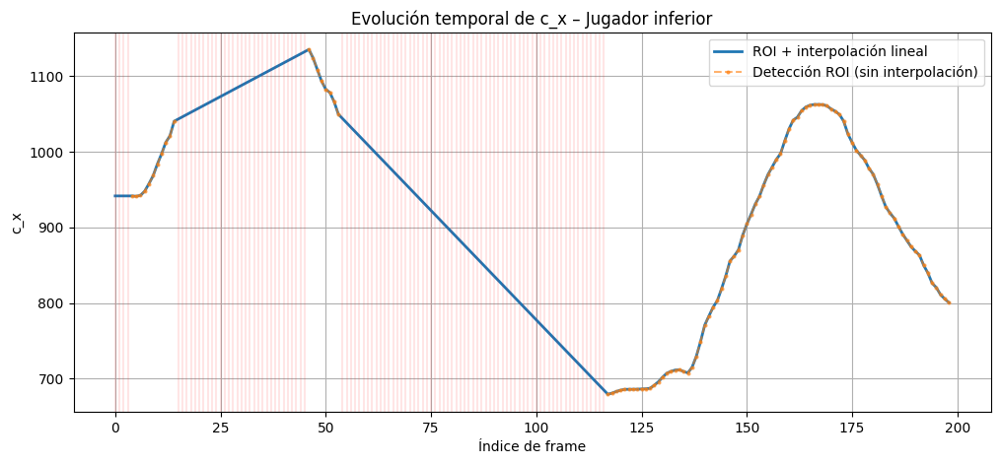

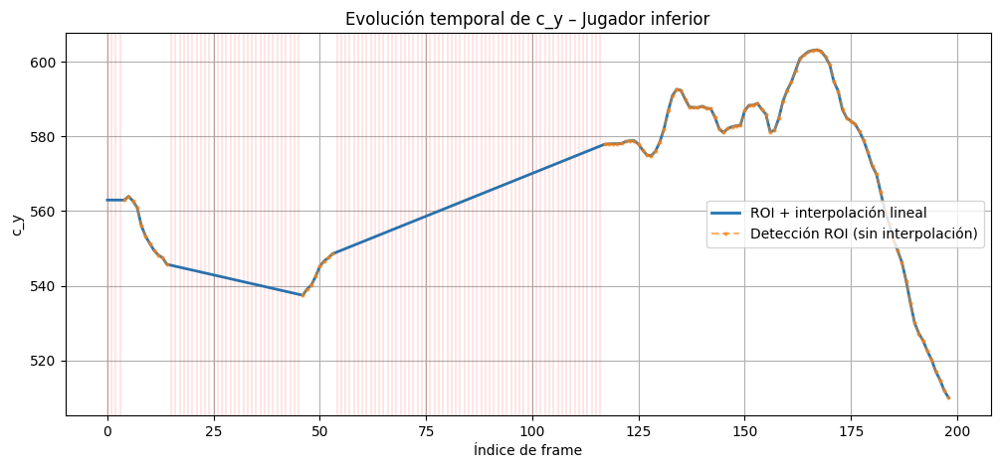

In [ ]:
# jugador inferior
frames, cx_b_raw, cy_b_raw, lost_b = extraer_cx_cy_sin_interp(
    datos_trackeo, "bottom_player"
)

cx_b_interp = np.array([pos[0] for pos in bottom_interp])
cy_b_interp = np.array([pos[1] for pos in bottom_interp])

# c_x
plot_evolucion_con_perdidas(frames, cx_b_raw, cx_b_interp, lost_b, ylabel="c_x", titulo="Evolución temporal de c_x – Jugador inferior")

# c_y
plot_evolucion_con_perdidas(frames, cy_b_raw, cy_b_interp, lost_b, ylabel="c_y", titulo="Evolución temporal de c_y – Jugador inferior")

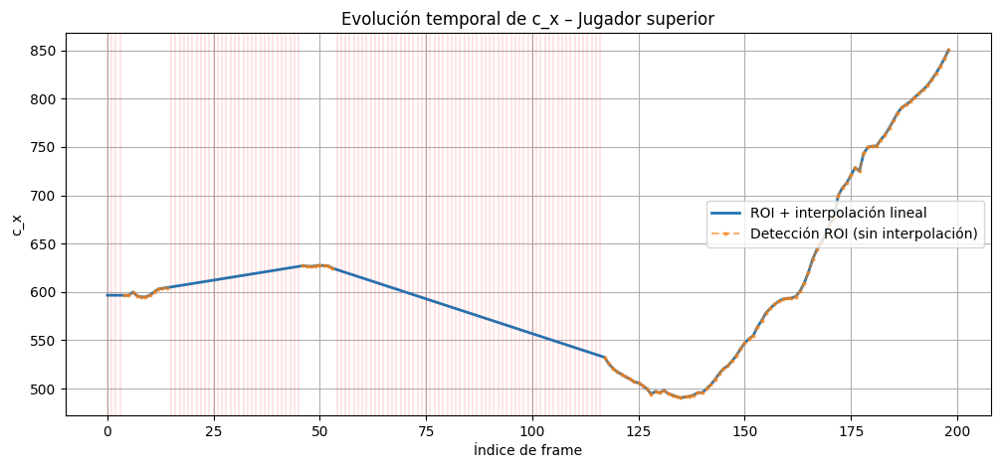

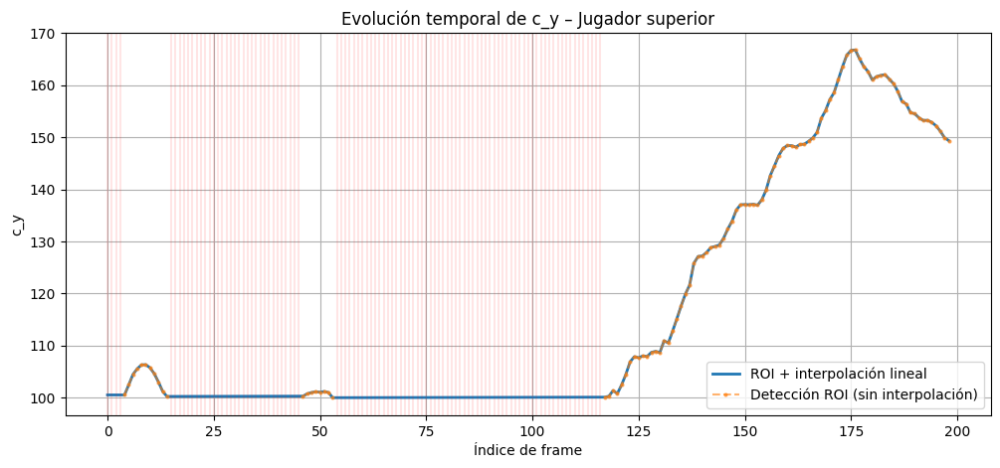

In [ ]:
# jugador superior
frames, cx_t_raw, cy_t_raw, lost_t = extraer_cx_cy_sin_interp(
    datos_trackeo, "top_player"
)

cx_t_interp = np.array([pos[0] for pos in top_interp])
cy_t_interp = np.array([pos[1] for pos in top_interp])

# c_x
plot_evolucion_con_perdidas(frames, cx_t_raw, cx_t_interp, lost_t, ylabel="c_x", titulo="Evolución temporal de c_x – Jugador superior")

# c_y
plot_evolucion_con_perdidas(frames, cy_t_raw, cy_t_interp, lost_t, ylabel="c_y", titulo="Evolución temporal de c_y – Jugador superior")

Centrando el análisis de las gráficas en la coordenada vertical $c_y$, que representa la posición vertical del centro de la **bounding box**, en el caso del **jugador inferior**,  se observa que durante el primer tramo del clip la señal de $c_y$ **sin interpolación** muestra gran cantidad de pérdidas. Incluso cuando se producen fallos de detección (marcados por las líneas verticales y situados en frames más tardíos), la **interpolación lineal trata de reconstruir una trayectoria suave** y **coherente con el movimiento real del jugador**, lo que indica que el **ROI** no cubre la región donde se mueve el jugador inferior durante gran parte del clip.

Por otro lado,  la gráfica correspondiente al **jugador superior** es muy similar a la vista en el jugador inferior, donde el primer tramo vuelve a ser el **más problematico**, junto a un **segundo** en el que las **limitaciones de ROI** no están apenas presentes, logrando así que la interpolación lineal haga un trabajo más fiel.


#### **CONCLUSIÓN**

Tras los análisis que hemos realizado, podemos decir que **gracias a la interpolación**, el movimiento de los jugadores va a poder ser **analizado y registrado** de forma **más estable** a lo largo del clip, proporcionando una base **muy robusta** para implementaciones posteriores como **el mapeo de posiciones en la pista a tiempo real** o el cálculo y estimación de **métricas** como la **velocidad** o **distancia recorrida** de cada uno de los jugadores.

Por tanto, el problema actual es la **búsqueda de un filtrado de jugadores** **más eficiente** que **ROI**, ya que, como bien dijimos anteriormente, la interpolación no corrige los errores estructurales derivados del filtrado por ROI, reforzando así la idea de que se trata de una mejora incremental y no de una solución definitiva al problema de selección de jugadores.

### **KEYPOINTS**

Como segunda y última aproximación al problema principal en la detección de jugadores con **YOLO**, tal  y como se explicó en el notebook dedicado a la extracción de keypoints `tennis_court_detector.ipynb`, es posible obtener una estimación precisa de la geometría de la pista de tenis a partir de un conjunto reducido de **puntos de interés/esquinas**. En este caso, estos puntos van a representar las **intersecciones y extremos de las líneas** de la pista, definiendo así una referencia del escenario de juego.

A diferencia del filtrado mediante **ROI**, que se basa únicamente en una región fija definida en el plano de la imagen, creemos que **utilizar los keypoints de la pista** es una **técnica generalizada** que no depende de una aproximación sobre dónde deberían estar los jugadores, sino que aprovecha el hecho de que, **NORMALMENTE**, los tenistas **se encuentran dentro de los límites de la pista**, o **cercanos a ellos**, teniendo una fuerte relación con estas líneas que la delimitan.

Además, mientras que ROI es totalmente dependiente a la perspectiva de la cámara en cada clip y la posición de los jugadores (especialmente del jugador superior), los **puntos de interés** permiten definir referencias **no estáticas** adaptadas a cada uno de los frames del clip, lo que nos va a permitir **razonar la posición de los jugadores en relación con elementos "invariantes" de la escena**, como las líneas del fondo o la línea central.

No obstante, como todo, a simple vista se nos vienen algunos **posibles problemas** que evaluaremos posteriormente según cómo se traten los keypoints para el filtrado: por ejemplo, aquellos clips donde los puntos de interés no sean del todo fiables.

Por tanto, para este filtrado se esperan **resultados mejores y más generalizables** que con ROI.



#### **DETECCIÓN DE KEYPOINTS (BREVE EXPLICACIÓN)**

Aunque ya está explicado en el notebook dedicado, de forma resumida, el proceso parte de una **red neuronal convolucional** entrenada para predecir un conjunto de **28 coordenadas (x, y)** correspondientes a **los puntos de interés de la pista**. Posteriormente, mediante técnicas de **procesado de imágenes** (detección de líneas con Hough, cálculo de intersecciones...) se ajustan los keypoints a las intersecciones de las lineas visibles en cada frame.

Por tanto y para este apartado, la detección de keypoints se considera como una **funcionalidad ya validada** cuya implementación y comportamiento ya ha sido analizado. De esta manera, las funciones utilizadas no serán comentadas y el objetivo de el resto de código no estará en cómo se detectan estos puntos, sino en **cómo se usan como referencia** para mejorar la selección y el seguimiento de los jugadores dentro de la pistsa.

Initial keypoints predicted for data/tracknet/Dataset/game3/Clip6/0090.jpg


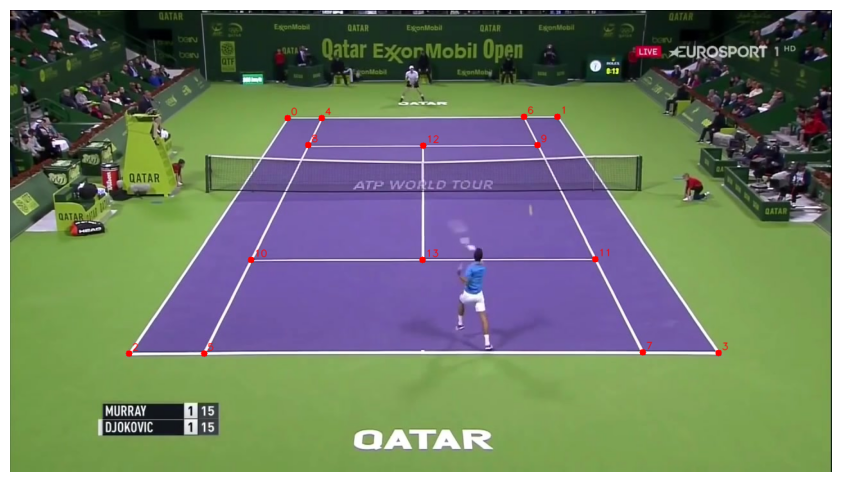

Initial keypoints predicted for data/tracknet/Dataset/game9/Clip3/0006.jpg


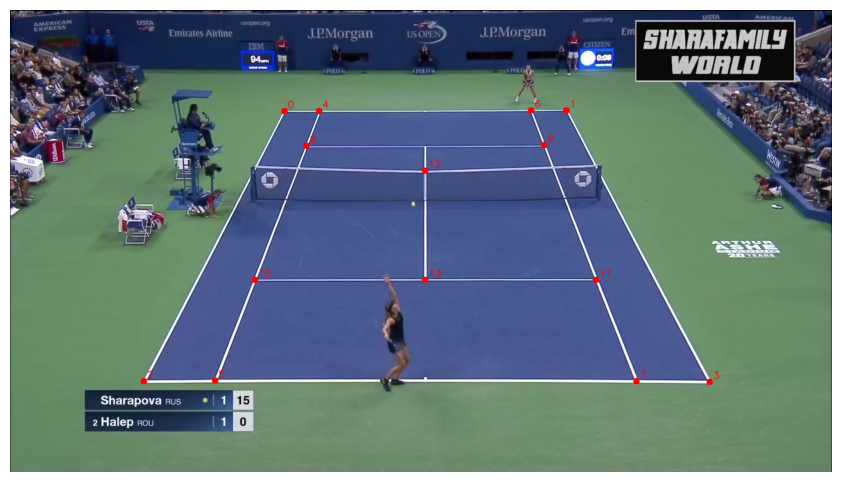

Initial keypoints predicted for data/tracknet/Dataset/game2/Clip3/0004.jpg


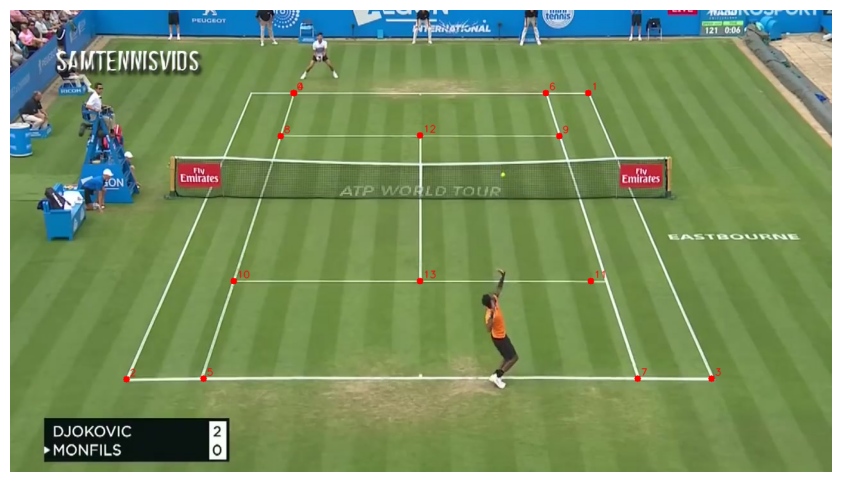

In [ ]:
# se genera el detector con los pesos ya preentrenados
detector = CourtLineDetector("drive/MyDrive/model_court.pth")

frames = frames_aleatorios(DATASET_DIR, 3)

for img_path in frames:
    # se cargan las imagenes
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # se detectan y se procesan/refinan
    court_keypoints = obtiene_y_refina_keypoints(img_path, detector)
    court_keypoints = court_keypoints.reshape(-1)

    # dibujado y visualizacion
    img_court = detector.draw_keypoints(img.copy(), court_keypoints)
    mostrar_imagen(img_court)

#### **PRUEBA EXPERIMENTAL 1: CENTRO DE LA BBOX CERCANA A CUALQUIER KP**

La idea de esta aproximación es que los **jugadores** suelen **estar cerca de la pista**, mientras que el resto de personas detectadas (recogepelota, jueces...) suelen situarse **a mayor distancia** de las líneas que la delimitan. De esta manera, **la distancia a estos keypoints** puede utilizarse como una medida indirecta de pertenencia a la zona de juego.

Dicho esto, para cada persona detectada por YOLO, se calcula el **centro de su bounding box** y se mide su **distancia euclídea a todos los keypoints de la pista**, quedándonos únicamente con la **distancia mínima**, que representa el grado de cercanía del individuo a la pista, independientemente de la línea concreta a la que esté proximo.

Matemáticamente, para un jugador con centro $\mathbf{c} = (c_x, c_y)$ y un conjunto de keypoints ${\mathbf{k}_i}$, se define:

$$d_{\min}(\mathbf{c}) = \min_i \left\lVert \mathbf{c} - \mathbf{k}_i \right\rVert_2$$

donde $\lVert \cdot \rVert_2$ indica la distancia euclídea.

Finalmente, las personas detectadas se **ordenan** de menor a mayor según esta distancia mínima y se seleccionan aquellas **dos** **más cercanas a la pista**, suponiendo que se corresponden con los dos jugadores del partido. Seguidamente, estos dos candidatos se separan en **jugador superior** y **jugador inferior** según su coordenada vertical $c_y$.


In [ ]:
# calcula la distancia minima del jugador a la pista
def distancia_minima_al_campo(centro_bbox, court_points):
    px, py = centro_bbox
    distancias = [
        np.linalg.norm([px - cx, py - cy])  # distancia euclidea
        for (cx, cy) in court_points
    ]
    return min(distancias)

# convierte la lista plana de coordenadas de la pista en una lista de puntos 2d
def keypoints_to_points(keypoints):
    pts = []
    for i in range(0, len(keypoints), 2):
        pts.append((keypoints[i], keypoints[i+1]))

    return pts

In [ ]:
def pipeline_kp_1(img_path, modelo):
  # se detectan y se procesan/refinan
  court_keypoints = obtiene_y_refina_keypoints(img_path, detector)
  # se convierten a pares de puntos
  court_points = keypoints_to_points(court_keypoints)

  # se carga la imagen
  img = cv2.imread(img_path)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # se dibujan los kp de la pista
  img_court = detector.draw_keypoints(img.copy(), court_keypoints.reshape(-1))

  # yolo
  predicciones = modelo(img_rgb, conf=0.4, classes=[0])

  bboxes = []
  for r in predicciones:
      for bbox in r.boxes:
          x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
          conf = float(bbox.conf[0].cpu().numpy())

          persona = {
              "bbox": [x1, y1, x2, y2],
              "conf": conf
          }

          bboxes.append(persona)


  # calculo de la distancia minima a la pista
  players_distancias = []

  for p in bboxes:
      cx, cy = bbox_center(p["bbox"])
      centro = (cx, cy)

      dist = distancia_minima_al_campo((cx, cy), court_points)

      players_distancias.append({
        **p,
        "cx": cx,
        "cy": cy,
        "dist": dist
      })

  # seleccion de jugadores
  if len(players_distancias) < 2:
      top_player = None
      bottom_player = None
  else:
      players_distancias.sort(key=lambda p: p["dist"])
      selected_players = players_distancias[:2]

      # separación top / bottom por coordenada vertical
      top_player, bottom_player = separar_top_bottom(selected_players)

  img_out = img_court.copy()

  if top_player is not None and bottom_player is not None:
      img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

  mostrar_imagen(img_out)

Initial keypoints predicted for data/tracknet/Dataset/game3/Clip1/0037.jpg

0: 384x640 4 persons, 62.4ms
Speed: 2.0ms preprocess, 62.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


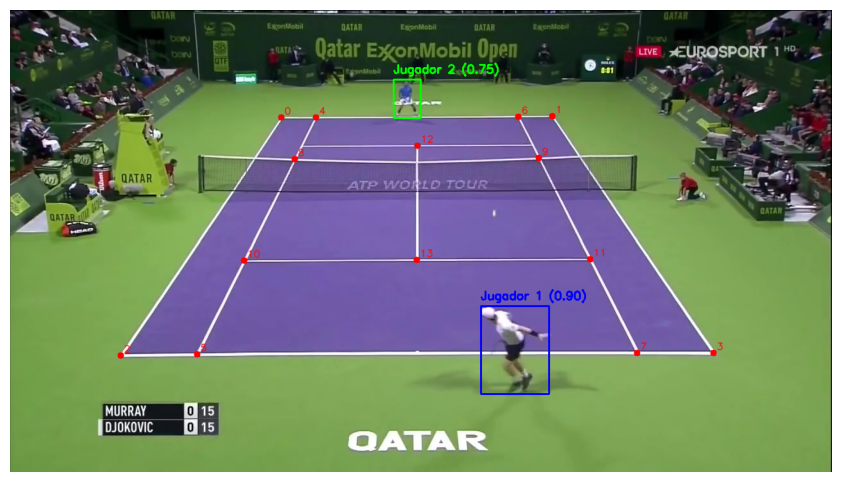

Initial keypoints predicted for data/tracknet/Dataset/game7/Clip2/0010.jpg

0: 384x640 8 persons, 62.4ms
Speed: 2.1ms preprocess, 62.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


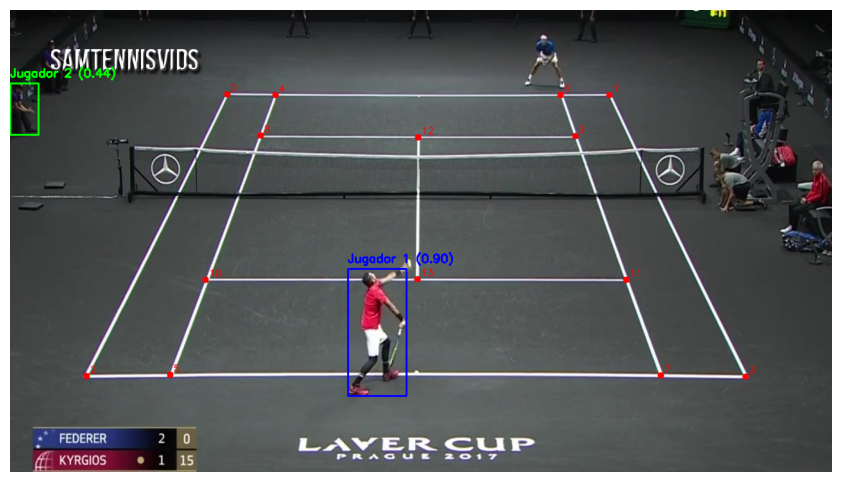

Initial keypoints predicted for data/tracknet/Dataset/game4/Clip7/0067.jpg

0: 384x640 9 persons, 62.5ms
Speed: 2.2ms preprocess, 62.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


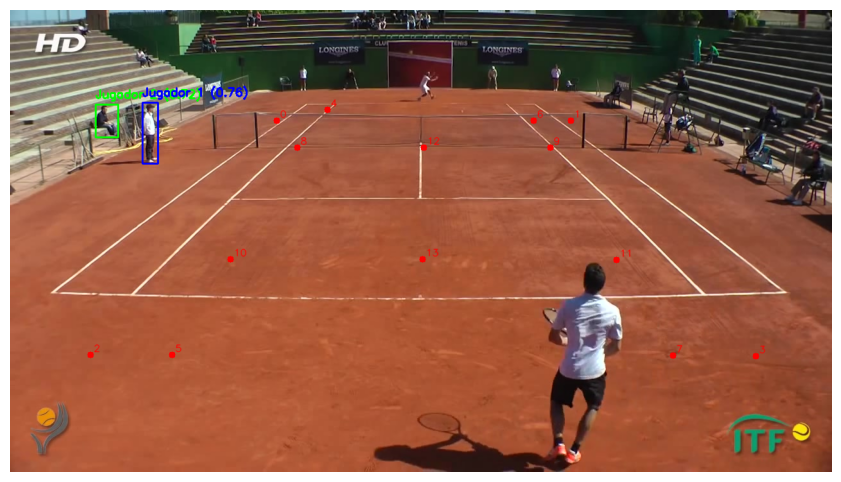

Initial keypoints predicted for data/tracknet/Dataset/game5/Clip15/0171.jpg

0: 384x640 9 persons, 62.4ms
Speed: 2.0ms preprocess, 62.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


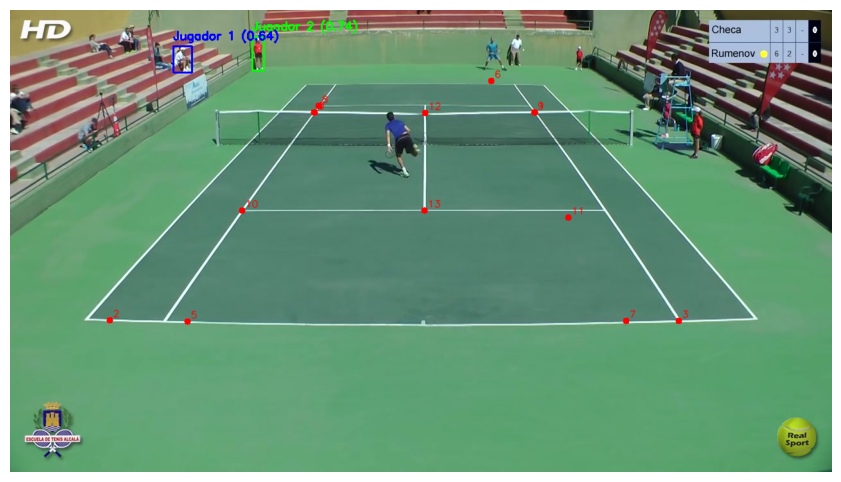

Initial keypoints predicted for data/tracknet/Dataset/game2/Clip1/0243.jpg

0: 384x640 8 persons, 62.4ms
Speed: 2.0ms preprocess, 62.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


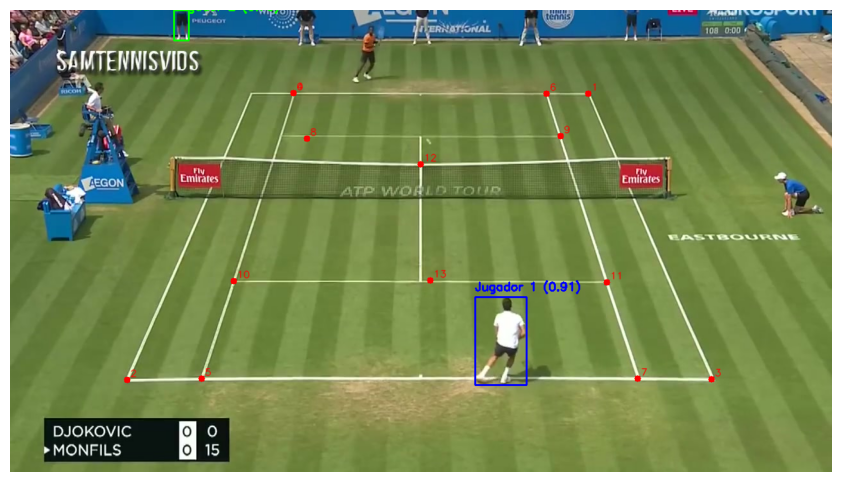

In [ ]:
frames = frames_aleatorios(DATASET_DIR, 5)

for img_path in frames:
   pipeline_kp_1(img_path, modelo)

Sin embargo, los resultados obtenidos muestran que esta aproximación presenta **grandes limitaciones**, incluso, a simple vista, mayores que **ROI**.

En primer lugar, como bien sabemos, los keypoints de la pista no están distribuidos de forma uniforme sobre toda la superficie de juego, sino que se concentran principalmente en las **líneas laterales**, **líneas de fondo** e **intersecciones**. Como consecuencia, una persona situada cerca de una línea lateral, aunque no forme parte del juego, puede estar geométricamente más cercana a uno de estos keypoints (aunque a nivel visual no lo parezca) que un jugador posicionado correctamente en el interior del campo, especialmente, en el caso del **jugador superior** (una vez más), y esto es debido principalmente a la perspectiva de la cámara, que comprime visualmente la parte superior del campo, reduciendo la separación visual entre jugadores y elementos externos, pero no geométricamente.

Otro de los principales problemas es que se corresponde con una técnica que no es capaz de seleccionar una persona para cada parte de la pista, como se puede observar en algunas de las imagenes de salida, donde para una misma zona se han detectado las dos posibles personas.

En consecuencia, aunque esta técnica parecía ser óptima al basarse únicamente en la estructura geométrica de la pista y no depender de regiones fijas como el ROI, el uso directo de la distancia mínima a los keypoints reales de la pista **no es suficiente para discriminar robustamente a los jugadores**.

Por tanto, vamos a buscar otras aproximaciones más robustas en la que los keypoints de la pista **no se utilicen de forma directa**, sino como base para definir **keypoints virtuales**, situados en regiones relevantes del campo para cada uno de los jugadores.

#### **PRUEBA EXPERIMENTAL 2: KP VIRTUALES**

La idea principal consiste en **definir manualmente dos puntos de interés virutales** para la asignación de los jugadores a lo largo del clip.
Para fundamentar los keypoints definidos, es importante tener en cuenta que **los jugadores no ocupan de forma uniforme toda la pista**, sino que su movimento se concentra mayoritariamente en **zonas muy específicas**, predominando, tanto para el jugador superior como para el inferior, posiciones próximas a sus respectivas **líneas de fondo**, desplazándose lateralmente y con pequeñas variaciones en profundidad.

Para verificarlo, se han definido una serie de funciones que nos permiten recopilar las posiciones detectadas de ambos jugadores a lo largo de **distintos clips** como un **heatmap**, donde las regiones de **mayor densidad de movimiento** coinciden con las áreas mencionadas anteriormente.

De esta manera, los **keypoints virtuales** no se van a definir de forma arbitraria, sino que se van a construir como **puntos representativos del comportamiento de los jugadores**.






In [ ]:
# funcion que recoge los centros de los jugadores (cuando son detectados)
# para un conjunto de clips utilizando ROI
def recolectar_centros_jugadores(clips, modelo, roi):
    posiciones = []

    for clip in clips:
        for img_path in sorted(glob.glob(os.path.join(clip, "*.jpg"))):
            img = cv2.imread(img_path)

            # se ejecuta el pipeline con filtrado de ROI para detectar a los supuestos
            # top y bottom player
            top, bottom = _pipeline_yolo_roi_jugadores(
                img, modelo, roi, draw_debug=False
            )

            if top:
                posiciones.append((top["cx"], top["cy"]))
            if bottom:
                posiciones.append((bottom["cx"], bottom["cy"]))

    return np.asarray(posiciones)

# función que crea el heatmap de posiciones
def crear_heatmap(posiciones, img_shape, sigma=25):
    h, w = img_shape[:2]
    heatmap = np.zeros((h, w), dtype=np.float32) # inicializado a 0

    for (x, y) in posiciones:
        x = int(np.clip(x, 0, w - 1))
        y = int(np.clip(y, 0, h - 1))
        heatmap[y, x] += 1

    # suavizado gaussiano
    heatmap = cv2.GaussianBlur(heatmap, (0, 0), sigma)

    # normalización
    heatmap /= heatmap.max() + 1e-6
    return heatmap

# función que muestra el heatmap sobre una imagen de referencia del conjunto de clips
def mostrar_heatmap(img, heatmap, alpha=0.9):
    heatmap_color = cv2.applyColorMap(
        (heatmap * 255).astype(np.uint8),
        cv2.COLORMAP_JET
    )

    overlay = cv2.addWeighted(img, 1 - alpha, heatmap_color, alpha, 0)

    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title("Heatmap de ocupación espacial de jugadores")
    plt.axis("off")
    plt.show()

No obstante, la detección de centros para cada uno de los jugadores se ha realizado mediante **ROI** como técnica de filtrado al ser la más "óptima" a nivel visual si se compara con la prueba experimental anterior con keypoints.

Total de posiciones acumuladas: 859


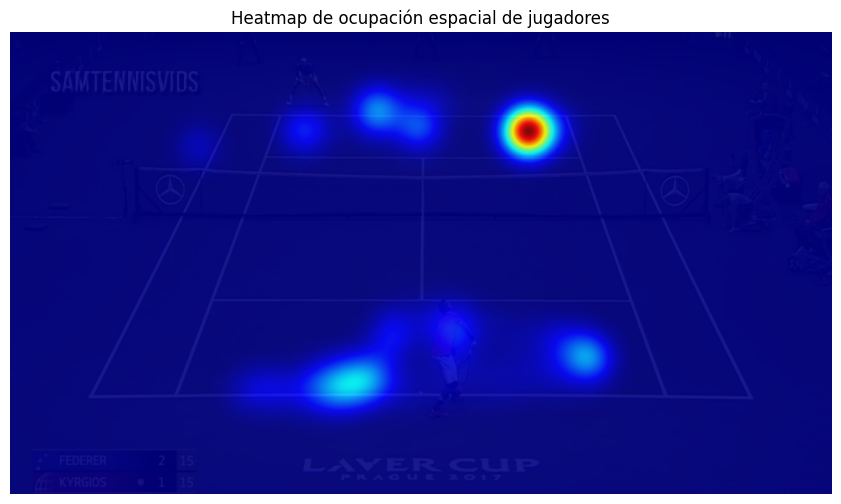

In [ ]:
# se seleccionan clips aleatorios
clips = clips_aleatorios(DATASET_DIR, num_games=3)

# se recogen las posiciones
posiciones = recolectar_centros_jugadores(clips, modelo, roi)
print(f"Total de posiciones acumuladas: {len(posiciones)}")

# imagen de referencia
img_ref = cv2.imread(sorted(glob.glob(os.path.join(clips[0], "*.jpg")))[0])

# se crea el heatmap
heatmap = crear_heatmap(posiciones, img_ref.shape)

# se muestra el resultado
mostrar_heatmap(img_ref, heatmap)

Si se relaciona el heatmap obtenido con los **índices asociados a cada uno de los keypoints reales**, tomamos como **más relevantes**:

* **jugador superior**:
  * kp[0]
  * kp[1]
  * kp[4]
  * kp[6]
  * kp[12]
* **jugador inferior**:
  * kp[2]
  * kp[3]
  * kp[5]
  * kp[7]
  * kp[13]

Initial keypoints predicted for data/tracknet/Dataset/game9/Clip7/0009.jpg


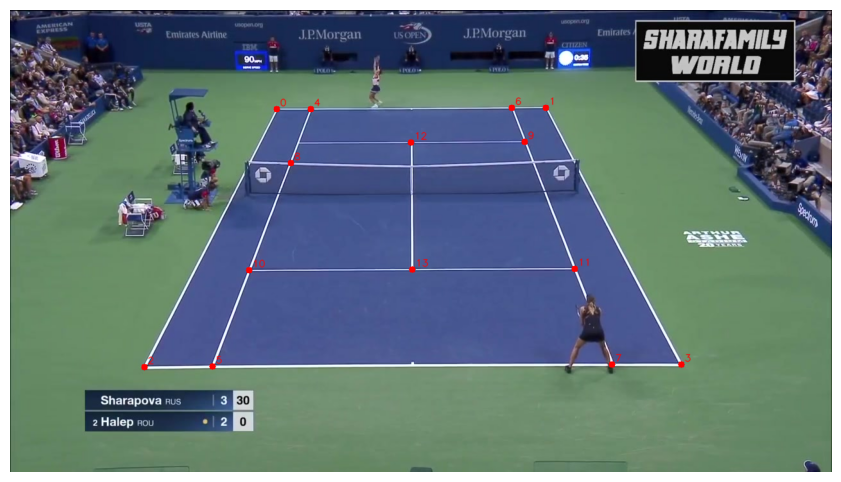

In [ ]:
# se genera el detector con los pesos ya preentrenados
detector = CourtLineDetector("drive/MyDrive/model_court.pth")

frames = frames_aleatorios(DATASET_DIR, 1)
img_path = frames[0]

# se cargan las imagenes
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# se detectan y se procesan/refinan
court_keypoints = obtiene_y_refina_keypoints(img_path, detector)
court_keypoints = court_keypoints.reshape(-1)

# se dibujan los kps refinados en la imagen de salida
img_court = detector.draw_keypoints(img.copy(), court_keypoints)

mostrar_imagen(img_court)

Por tanto, y a partir de los keypoints escogidos, se definen como los **dos únicos kp virtuales**: uno para la **mitad de la mitad superior** de la pista y otro para la **mitad de la mitad inferior**, que bajo nuestro punto de vista son los que representan de forma más fiel las **zonas donde los jugadores suelen posicionarse durante el juego**.



---



Una vez definidos estos keypoints virtuales, el proceso de asignación de jugadores se **reformula** como un **problema de optimización por coste**. De esta manera, para cada persona detectada por YOLO se **calcula la distancia a ambos keypoints virtuales (superior e inferior)**. A continuación, se evalúan todas las combinaciones posibles de asignación entre personas y keypoints, seleccionando **aquella que minimiza la suma de distancias** entre el jugador asignado a la parte superior y su keypoint correspondiente, e igual para la parte inferior.

Con esta técnica se espera una **mejora** con respecto a la anterior al aprovechar la **información geométrica** de la pista, pero evitando los problemas derivados de utilizar directamente los keypoints reales, siendo referencias **más estables y discriminativas**. En primer lugar, nos permite **evitar seleccionar personas cercanas a un único punto extremo de la pista**, ya que los keypoints virtuales se encuentran en posiciones internas y representativas del área de juego. En segundo lugar, **garantiza explícitamente que se selecciona un jugador para cada mitad de la pista**, resolviendo aquellos casos en los que varias personas aparecen en la misma zona, muy presentes en la prueba experimental anterior.



In [ ]:
# función que define los kp virtuales manualmente a partir de los reales

def kp_virtuales(court_keypoints):
    # parte superior de la pista

    # se almacenan los kps reales más relevantes, que
    # corresponden a las zonas donde más presente está el jugador superior en
    # un clip
    top_left  = court_keypoints[0]
    top_right = court_keypoints[1]

    sub_top_left = court_keypoints[4]
    sub_top_right = court_keypoints[6]

    mid_top = court_keypoints[12]

    # se calcula el punto medio de la linea final superior para pista de dobles
    kp_top = midpoint(top_left, top_right)
    # se calcula el punto medio de la linea final superior para pista individual
    kp_sub_top = midpoint(sub_top_left, sub_top_right)

    # se calcula el punto intermedio en los medios de la linea final superior
    kp_parte_superior = midpoint(kp_top, kp_sub_top)

    # se calcula el punto intermedio final entre la parte superior y el punto
    # intermedio de la mitad de la pista superior
    kp_parte_superior = midpoint(kp_parte_superior, mid_top)

    # parte inferior de la pista

    # se almacenan los kps reales más relevantes, que
    # corresponden a las zonas donde más presente está el jugador inferior en
    # un clip
    bot_left  = court_keypoints[2]
    bot_right = court_keypoints[3]

    sub_bot_left = court_keypoints[5]
    sub_bot_right = court_keypoints[7]

    mid_bottom = court_keypoints[13]

    # se calcula el punto medio de la linea final inferior para pista de dobles
    kp_bot = midpoint(bot_left, bot_right)
    # se calcula el punto medio de la linea final inferior para pista individual
    kp_sub_bot = midpoint(sub_bot_left, sub_bot_right)

    # se calcula el punto intermedio en los medios de la linea final inferior
    kp_parte_inferior = midpoint(kp_bot, kp_sub_bot)

    # se calcula el punto intermedio final entre la parte inferior y el punto
    # intermedio de la mitad de la pista inferior
    kp_parte_inferior = midpoint(kp_parte_inferior, mid_bottom)

    return kp_parte_superior, kp_parte_inferior

In [ ]:
# función que se encarga de seleccionar los jugadores mediante la optimización de coste
# y los kp virtuales ya definidos

def asigna_jugadores_a_kp_virtuales(bboxes_players, court_keypoints):
    kp_top, kp_bottom = kp_virtuales(court_keypoints)

    if len(bboxes_players) < 2:
        return None, None

    # para cada jugador se obtiene el centro de la bbox y se calcula la dist
    # euclidea a cada uno de los kp virtuales
    players = []
    for p in bboxes_players:
        cx, cy = bbox_center(p["bbox"])
        players.append({
            **p,
            "cx": cx,
            "cy": cy,
            "d_top": np.linalg.norm([cx - kp_top[0], cy - kp_top[1]]),
            "d_bottom": np.linalg.norm([cx - kp_bottom[0], cy - kp_bottom[1]])
        })

    # se selecciona la par que minimiza el coste total, que se corresponde con
    # la suma de las distancias del jugador candidato superior al kp superior, y
    # mismo para el inferior.
    best_cost = float("inf")
    best_pair = None

    for i in range(len(players)):
        for j in range(len(players)):
            if i == j:
                continue
            cost = players[i]["d_top"] + players[j]["d_bottom"] # distancia del jugador i al kp virtual superior + la distancia del jugador j al kp virtual inferior
            if cost < best_cost:
                best_cost = cost
                best_pair = (players[i], players[j])

    return best_pair

In [ ]:
def pipeline_kp_2(img_path, modelo):
    # se detectan y refinan los keypoints de la pista
    court_keypoints = obtiene_y_refina_keypoints(img_path, detector)
    court_keypoints_flat = court_keypoints.reshape(-1)

    # se carga la imagen y se dibujan los keypoints
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_court = detector.draw_keypoints(img.copy(), court_keypoints_flat)

    # YOLO
    predicciones = modelo(img_rgb, conf=0.4, classes=[0])

    bboxes_players = []
    for r in predicciones:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            bboxes_players.append({
                "bbox": [x1, y1, x2, y2],
                "conf": conf
            })

    # asignación por keypoints virtuales
    top_player, bottom_player = asigna_jugadores_a_kp_virtuales(
        bboxes_players,
        court_keypoints
    )

    img_out = img_court.copy()

    # dibujar keypoints virtuales (para debug/visualización)
    kp_top, kp_bottom = kp_virtuales(court_keypoints)
    cv2.circle(img_out, (int(kp_top[0]), int(kp_top[1])), 8, (0, 255, 255), -1)
    cv2.putText(img_out, "KP virtual TOP", (int(kp_top[0]) + 10, int(kp_top[1])),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 255), 2)

    cv2.circle(img_out, (int(kp_bottom[0]), int(kp_bottom[1])), 8, (0, 255, 255), -1)
    cv2.putText(img_out, "KP virtual BOTTOM", (int(kp_bottom[0]) + 10, int(kp_bottom[1])),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 255), 2)

    # si hay dos jugadores, dibujar sus bbox
    if top_player is not None and bottom_player is not None:
        img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    mostrar_imagen(img_out)

Initial keypoints predicted for data/tracknet/Dataset/game5/Clip3/0071.jpg


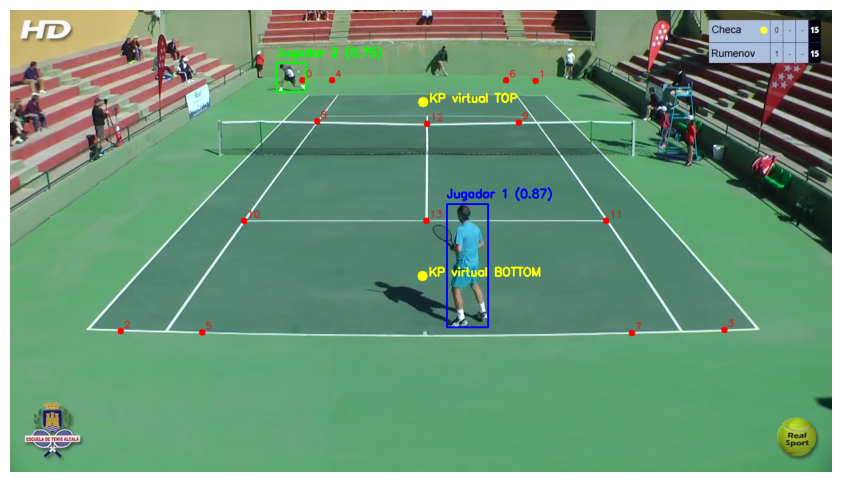

Initial keypoints predicted for data/tracknet/Dataset/game2/Clip7/0164.jpg


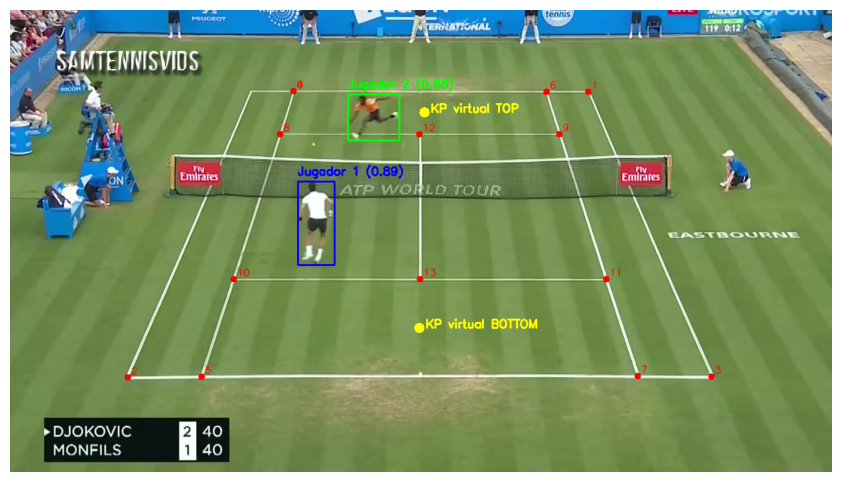

Initial keypoints predicted for data/tracknet/Dataset/game7/Clip1/0105.jpg


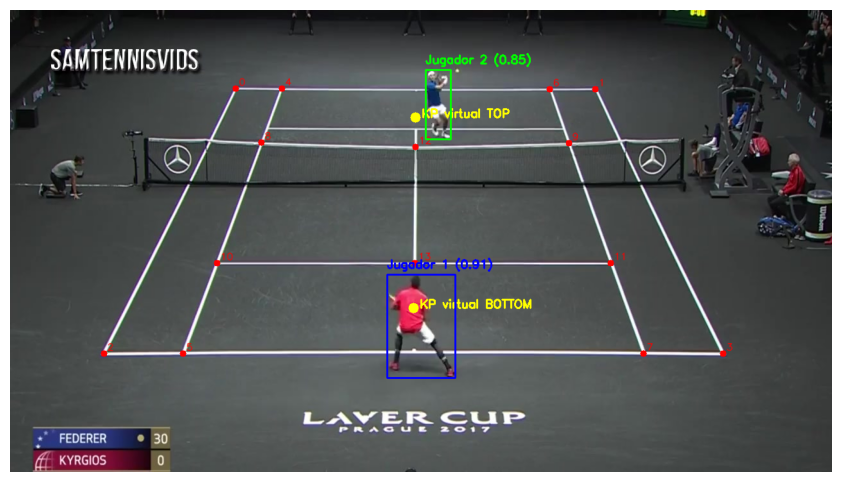

Initial keypoints predicted for data/tracknet/Dataset/game10/Clip6/0233.jpg


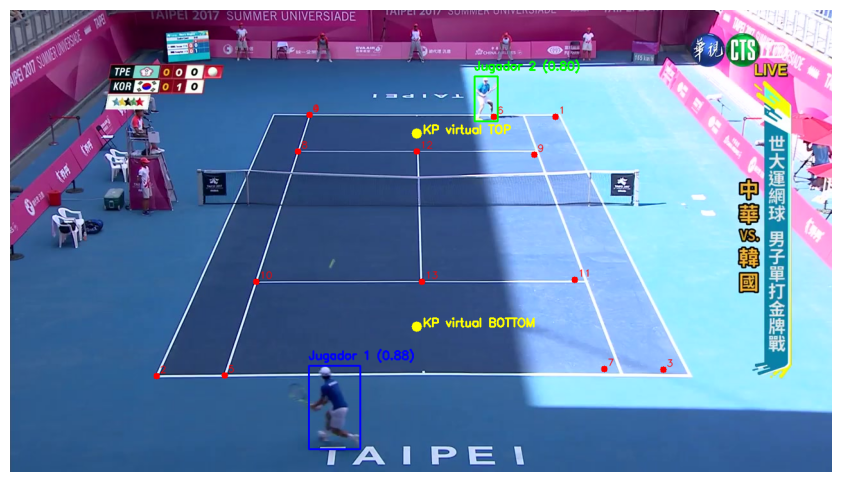

Initial keypoints predicted for data/tracknet/Dataset/game3/Clip6/0206.jpg


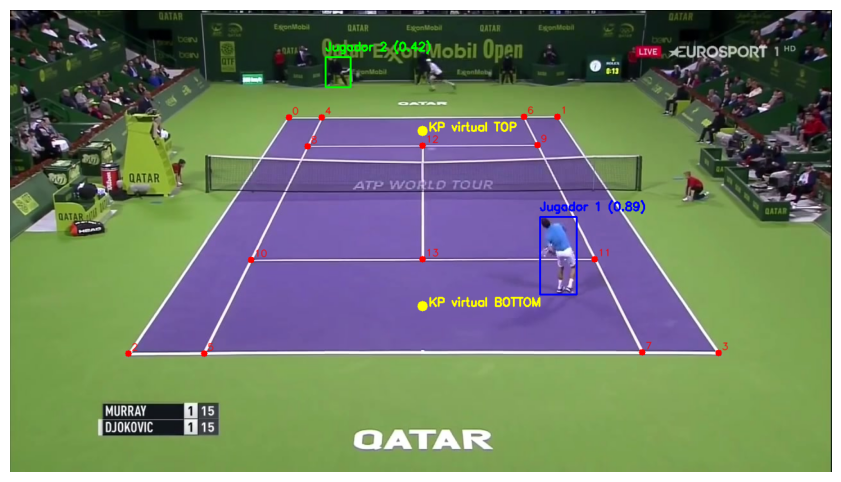

In [ ]:
frames = frames_aleatorios(DATASET_DIR, 5)

for img_path in frames:
   pipeline_kp_2(img_path, modelo)

Los resultados obtenidos al aplicar el filtrado basado en **keypoints virtuales** muestran una mejora **clara** respecto a la prueba experimental anterior.

En los frames mostrados, correspondientes a clips que ya habían sido evaluados previamente con la métrica de distancia mínima, se observa que el nuevo criterio **elimina los errores estructurales** que se producían cuando jugadores no pertenecientes al juego  se encontraban próximos a alguno de los keypoints reales de la pista. En esos casos, la **distancia mínima no era un criterio suficientemente discriminativo**, ya que no incorporaba, como sí se hace en este caso, ninguna indicación sobre la **zona funcional de juego**.

Otro aspecto relevante es que, con esta estrategia, **siempre se busca un jugador cercano a la parte superior de la pista y otro cercano a la parte inferior**, lo que se refleja claramente en las visualizaciones,  donde en todos los ejemplos aparece exactamente un jugador asignado a cada mitad de la pista, independientemente de la presencia de otras personas en el frame (aunque en algunos casos falle). Sin embargo, en la **prueba anterior** podían darse situaciones en las que **ambos jugadores seleccionados se encontraban en la misma mitad de la pista**.

Además, los resultados muestran que estas **características** propias de su comportamiento **se mantienen entre distintos partidos, superficies y ángulos de cámara**, lo que refuerza lo dicho teóricamente sobre los keypoints virtuales, que al estar definidos a partir de la geometría estable de la pista, generalizan **mejor que el uso directo de keypoints reales aislados**.





---

Para complementar los resultados obtenidos sobre un **frame individual**, se aplica sobre **clips completos de vídeo**, permitiendo evaluar su comportamiento en un escenario temporal continuo.

Debido al **alto coste computacional** asociado a la detección y refinamiento de los keypoints de la pista, principalmente en **tiempo de cómputo**, la estimación de los keypoints **no se realiza en cada frame**, sino **cada 7 frames**, puesto que realmente, la **geometría de dla pista para un mismo clip permanece invariante** a lo largo de un clip, mientras que los jugadores son los elementos dinámicos de la escena.

Al igual que los keypoints detectados se **reutilizan** durante varios frames consecutivos, los keypoints virtuales calculados también.


In [ ]:
fps = 30
img_dir = "data/tracknet/Dataset/game7/Clip4"
img_paths = sorted(glob.glob(os.path.join(img_dir, "*.jpg")))

out_path = "players_tracking_kp_virtuales.mp4"
fourcc = cv2.VideoWriter_fourcc(*"mp4v")
video_writer = cv2.VideoWriter(out_path, fourcc, fps, (W, H))

current_court_keypoints = None

for frame_idx, img_path in enumerate(img_paths):
    # se carga la imagen
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # se actualizan los kp de la pista cada 7 frames
    if frame_idx % 7 == 0 or current_court_keypoints is None:
        try:
            # se obtienen y refinan los keypoints de la pista reales mediante postprocesado
            current_court_keypoints = obtiene_y_refina_keypoints(
                img_path,
                detector
            )
        except Exception as e:
            print(f"Error {frame_idx}: {e}")
            current_court_keypoints = None

    # si no hay keypoints válidos, se escribe frame limpio sin nada mas
    if current_court_keypoints is None:
        video_writer.write(img)
        continue

    # se dibujan los kp reales de la pista
    img_out = detector.draw_keypoints(
        img.copy(),
        current_court_keypoints.reshape(-1)
    )

    # yolo para la detección de personas
    predicciones = modelo(img_rgb, conf=0.4, classes=[0])

    bboxes_players = []
    for r in predicciones:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            bboxes_players.append({
                    "bbox": [int(x1), int(y1), int(x2), int(y2)],
                    "conf": conf
            })

    if len(bboxes_players) < 2:
        video_writer.write(img_out)
        continue

    # se determinan los jugadores (superior e inferior) mediante los kp virtuales
    top_player, bottom_player = asigna_jugadores_a_kp_virtuales(
        bboxes_players,
        current_court_keypoints
    )

    if top_player is None or bottom_player is None:
        video_writer.write(img_out)
        continue


    # --- dibujos sobre la imagen de salida ---

    # se dibujan los kp virtuales para debug
    kp_top, kp_bottom = kp_virtuales(current_court_keypoints)

    cv2.circle(img_out, (int(kp_top[0]), int(kp_top[1])), 8, (0, 255, 255), -1)
    cv2.putText(
        img_out,
        "KP virtual TOP",
        (int(kp_top[0]) + 10, int(kp_top[1])),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.6,
        (0, 255, 255),
        2
    )

    cv2.circle(img_out, (int(kp_bottom[0]), int(kp_bottom[1])), 8, (0, 255, 255), -1)
    cv2.putText(
        img_out,
        "KP virtual BOTTOM",
        (int(kp_bottom[0]) + 10, int(kp_bottom[1])),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.6,
        (0, 255, 255),
        2
    )

    # se dibujan las bbox de jugadores
    img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    video_writer.write(img_out)
video_writer.release()
print("Vídeo generado:", out_path)

Vídeo generado: players_tracking_kp_virtuales.mp4


Tras visualizar su comportamiento sobre un clip, se puede ver como realmente, aun siendo mejor que filtrados previos, **no es del todo robusto**. En concreto y como de normal, el **jugador inferior** es detectado constantemente a lo largo del clip, mientras que los errores vuelven a concentrarse en la **selección del jugador superior**.

Este comportamiento es curioso ya que se producen **fallos incluso en frames donde los keypoints reales de la pista están definidos con gran precisión**, y donde el **keypoint virtual superior** se encuentra correctamente situado en la región esperada de la pista. A pesar de ello, el sistema llega a asignar erróneamente como jugador superior a un **recogepelotas**.

Viendo que se corresponde con un comportamiento ya visto en la prueba anterior, donde también se utilizaban los keypoints de la pista, la **principal causa** es que el razonamiento geométrico se realiza **directaemnte en la proyección de la cámara**, es decir, en el **plano imagen**. De esta manera, la **distancia aparente** entre un jugador y un keypoint de la pista **no gurda una relación directa con la distancia real sobre la pista** debido a la **perspectiva**. Es por ello por lo que personas situadas fuera del terreno de juego pero próximas visualmente al keypoint virtual en la imagen pueden tener una distancia menor que el propio jugador, dando lugar a asignaciones incorrectas.

Por tanto, aunque el uso de keypoints virtuales es **más eficiente** que los métodos previos, sigue estando **limitado**.

In [ ]:
!ffmpeg -y -i players_tracking_kp_virtuales.mp4 -vcodec libx264 -pix_fmt yuv420p players_tracking_kp_virtuales_fix.mp4 > /dev/null 2>&1
display(Video("players_tracking_kp_virtuales_fix.mp4", embed=True))

#### **PRUEBA EXPERIMENTAL 3: KP VIRTUALES + HOMOGRAFÍA INVERSA**

Tras las conclusiones obtenidas de la segunda prueba experimental, analizamos como último cambio/mejora conceptual la **asignacion de jugadores en el plano de la pista** y no directamente en la proyección de la cámara, como hacíamos anteriormente. Para ello, se combinan los **keypoints virtuales definidos previamente** con la **homografía inversa**, que permite transformar posiciones desde el plano imagen al **sistema de referencia real de la pista de tenis**.



#### **HOMOGRAFÍA INVERSA (BREVE EXPLICACIÓN)**

Aunque ya está explicado detalladamente en su notebook `player_map_position.ipynb`, a partir de un conjunto de puntos de interés de la pista, es posible estimar una **homografía** que relaciona la vista de la cámara con un **modelo de pista**. En este caso, dicha homografía se utiliza de **forma inversa** para proyectar las posiciones de los jugadores.



La principal diferencia de esta técnica es que la **distancia entre jugadores y keypoints virtuales deja de evaluarse en el plano imagen**, como se dijo, donde la perspectiva y proyección de la cámara distorsonia los cálculos, y pasa a calcularse en un **espacio coherente**, donde las distancias representan desplazamientos reales sobre la pista. De este modo, gran parte de los problemas observadas en pruebas anteriores, especialmente en la **mitad superior del campo**.


Otra de las principales diferencias respecto a los enfoques anteriores es que **no se utiliza el centro geométrico de la bounding box**, sino un **punto** siutado en la **parte inferior de la misma**, concretamente el punto **medio del borde inferior**, que aproxima la **posición de los pies del jugador** sobre la pista. El motivo principal de esta decisión que hemos tomado esta relacionado con el uso de la **homografía inversa** y con el cambio de espacio de trabajo que esto supone: la homografia describe una corespondencia válida entre puntos que pertenece al **mismo plano físico**, es decir, el planon de juego. Sin embargo, el centro de la bounding box corresponde con una zona elevada del cuerpo que **no se encuentra en contacto conn la pista** y, por tanto, **no pertenece estrictamente al plano sobre el que se define la homografía**.

Es por ello por lo que, aunque exístia la posibilidad de utilizar **YOLO-pose** para extraer los keypoints correspondientes a los tobillos de los pies y posteriormente calcular el centro de estos, nos hemos decantado por hacerlo **manualmente** para **reducir el coste computacional**, obteniendo como resultado una aproximación muy cercana.

De esta manera, ahora sí contamos con un punto **mucho más estable** que sí está situado sobre el plano de juego.



In [ ]:
# funcion que calcula el punto de la bounding box que simula el centro de los pies
# del jugador
def bbox_center_pies(bb):
  return (int((bb[2] + bb[0]) / 2) , int(bb[3]))

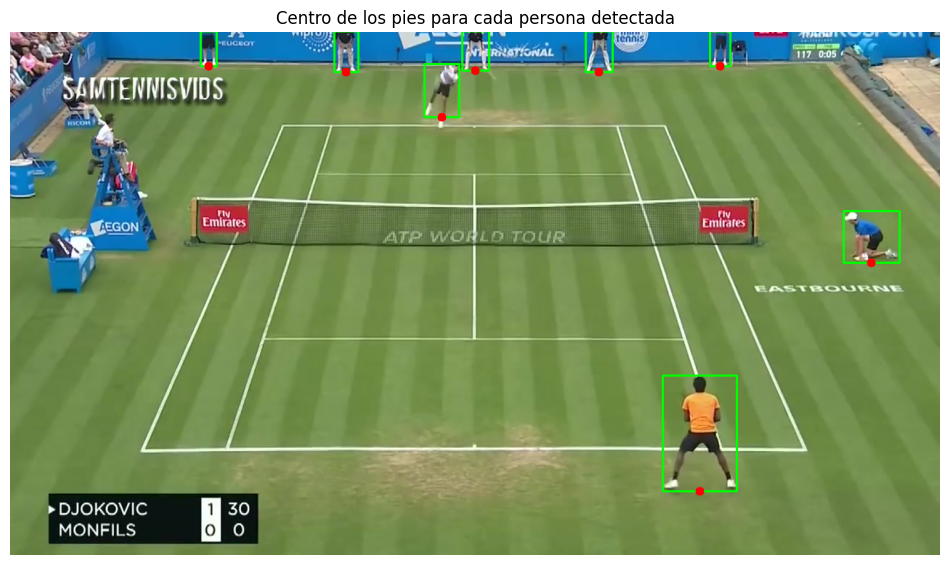

In [ ]:
# se carga la imagen
img_path = "data/tracknet/Dataset/game2/Clip2/0000.jpg"
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# deteccionn de yolo
predicciones = modelo(img_rgb, conf=0.4, classes=[0], verbose=False)

img_out = img.copy()

for r in predicciones:
    for bbox in r.boxes:
        x1, y1, x2, y2 = map(int, bbox.xyxy[0].cpu().numpy())
        conf = float(bbox.conf[0].cpu().numpy())

        # se dibuja la bbox de cada persona
        cv2.rectangle(
            img_out,
            (x1, y1),
            (x2, y2),
            (0, 255, 0),
            2
        )

        # calcula el centro de los pies
        cx_pies, cy_pies = bbox_center_pies([x1, y1, x2, y2])

        # centro de los pies dibujado como un punto
        cv2.circle(
            img_out,
            (cx_pies, cy_pies),
            6,
            (0, 0, 255),
            -1
        )

plt.figure(figsize=(12, 8))
plt.imshow(cv2.cvtColor(img_out, cv2.COLOR_BGR2RGB))
plt.title("Centro de los pies para cada persona detectada")
plt.axis("off")
plt.show()

Una vez más, la **asignación de jugadores** se formula como un **problema de optimización de coste**.

En primer lugar, se calcula la **homografía inversa** $H^{-1}$ para posteriormente, y para cada combinación posible de dos jugadores distintos, se **proyecta el punto de los pies de cada jugador al plano de la pista** mediante esta y se calcula el **coste geométrico** definido como la suma de distancias **en el plano de la pista** mediante la **distancia euclídea**, tal y como se hizo en el experimento anterior.


In [ ]:
# función que asigna los jugadores superior e inferior utilizando la posicion
# de los pies de cada jugador.

def asigna_jugadores_por_pies(players, kp_top_court, kp_bottom_court, H):
    # a partir de la homografía, se calcula la inversa (imagen -> pista)
    H_inv = h_inv(H)

    # si no hay al menos dos jugadores, no es posible asignar ambos
    if len(players) < 2:
        return players[0], None

    best_cost = float("inf")
    best_pair = None

    # se prueban todos los pares de jugadores distintos
    for i in range(len(players)):
        for j in range(len(players)):
            if i == j:
                continue

            # --- pies de jugadores --> pista ---

            # se proyectan los pies del jugador candidato superior
            p_top = image_to_court(
                np.array([players[i]["x_c"], players[i]["y_c"]], dtype=np.float32),
                H_inv
            )

            # se proyectan los pies del jugador candidato inferior
            p_bot = image_to_court(
                np.array([players[j]["x_c"], players[j]["y_c"]], dtype=np.float32),
                H_inv
            )

            # calcula el coste en coord de pista
            cost = (
                np.linalg.norm(p_top - kp_top_court) +
                np.linalg.norm(p_bot - kp_bottom_court)
            )

            # se actualiza el coste
            if cost < best_cost:
                best_cost = cost
                best_pair = (players[i], players[j])

    return best_pair

Para el pipeline aplicable sobre un frame, destacamos la **estimación de la homografía** entre la imagen y una representación plana de la pista a partir de los **keypoints reales de la pista**, junto a la seguida **proyección de los pies de los jugadores al espacio de la pista mediante la homografía inversa**.

In [ ]:
def pipeline_kp_3_pies_homografia(img_path, modelo, detector, court_points):
    # se carga la imagen
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # yolo para la deteccion de personas
    results = modelo(img_rgb, conf=0.4, verbose=False, classes=[0])

    bboxes_players = []
    for r in results:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            bboxes_players.append({
                "bbox": [int(x1), int(y1), int(x2), int(y2)],
                "conf": conf
            })

    # se obtienen y refinan los keypoints reales + homografia
    _, court_keypoints, H = process_court_image(
        img_path,
        detector,
        crop_size=110
    )

    # se crea la imagen de salida
    img_out = img.copy()

    # se calcula el centro inferior de los bbox (pies)
    for bb in bboxes_players:
        x_c, y_c = bbox_center_pies(bb["bbox"])
        bb["x_c"] = x_c
        bb["y_c"] = y_c

    # keypoints virtuales en pista
    kp_top_court, kp_bottom_court = kp_virtuales(court_points)

    # se asignan los jugadores por los pies y la homografia inversa
    top_player, bottom_player = asigna_jugadores_por_pies(
        bboxes_players,
        kp_top_court,
        kp_bottom_court,
        H
    )

    # --- dibujado sobre la imagen de salida ---

    # keypoints reales
    img_out = detector.draw_keypoints(
        img_out,
        court_keypoints.reshape(-1)
    )

    # pies de los jugadores seleccionados
    # jugador superior
    if top_player is not None:
        cv2.circle(
            img_out,
            (top_player["x_c"], top_player["y_c"]),
            6,
            (0, 255, 255),  # amarillo
            -1
        )
    # jugador inferior
    if bottom_player is not None:
        cv2.circle(
            img_out,
            (bottom_player["x_c"], bottom_player["y_c"]),
            6,
            (0, 255, 255),  # amarillo
            -1
        )

    # bbox de los jugadores seleccionados
    if top_player is not None and bottom_player is not None:
        img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(img_out, cv2.COLOR_BGR2RGB))
    plt.title(f"Frame procesado: {os.path.basename(img_path)}")
    plt.axis("off")
    plt.show()

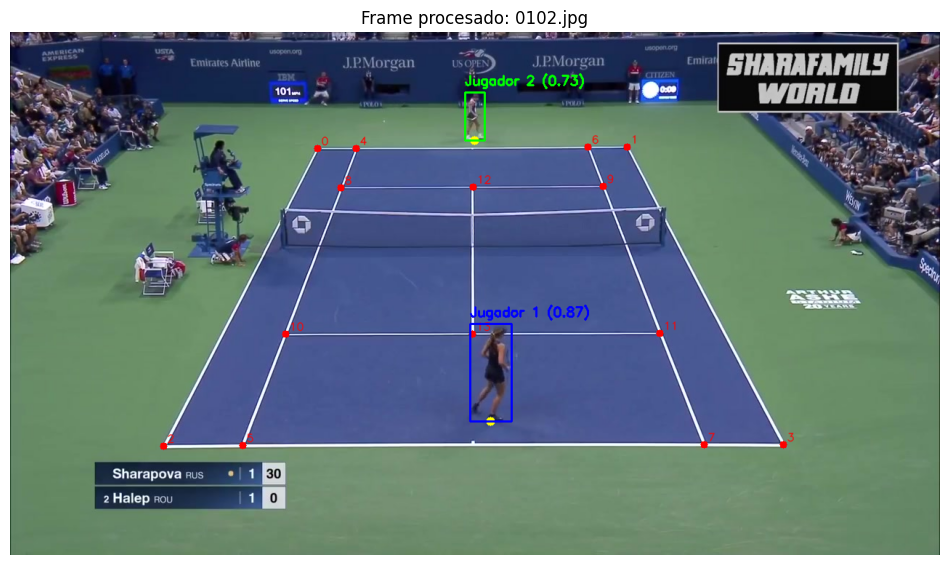

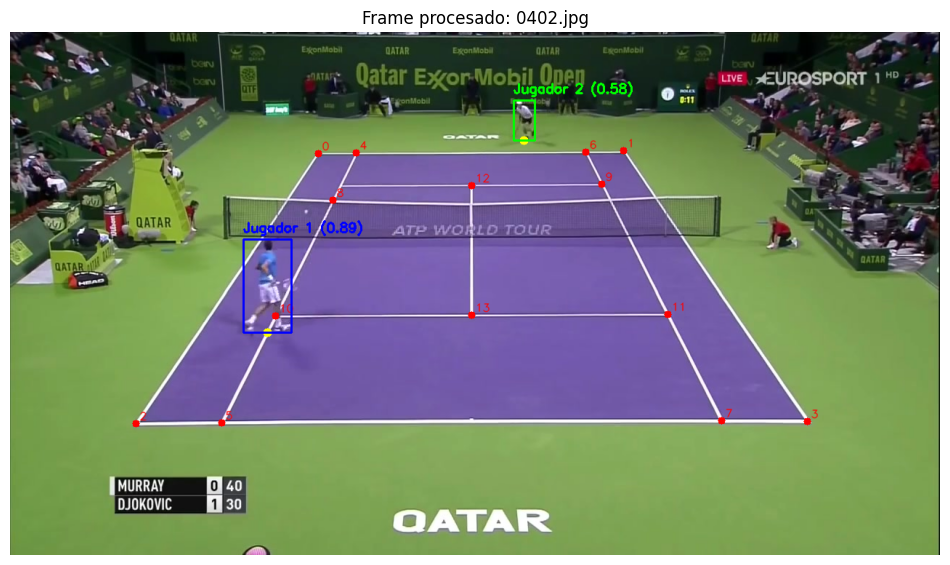

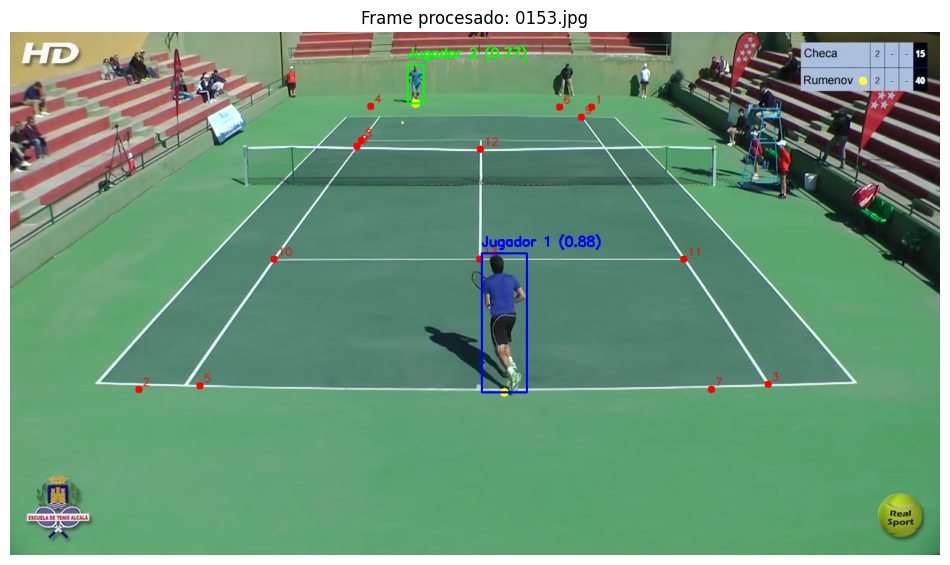

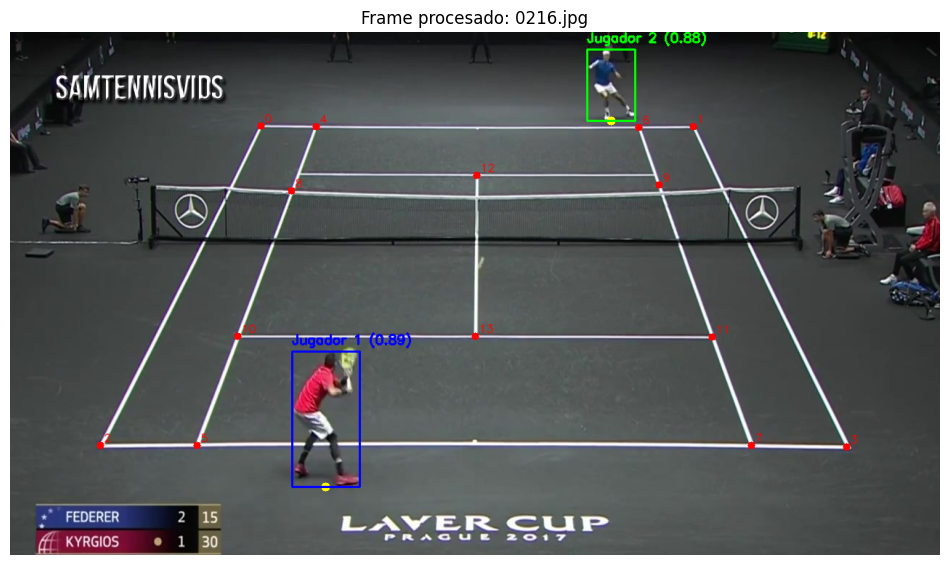

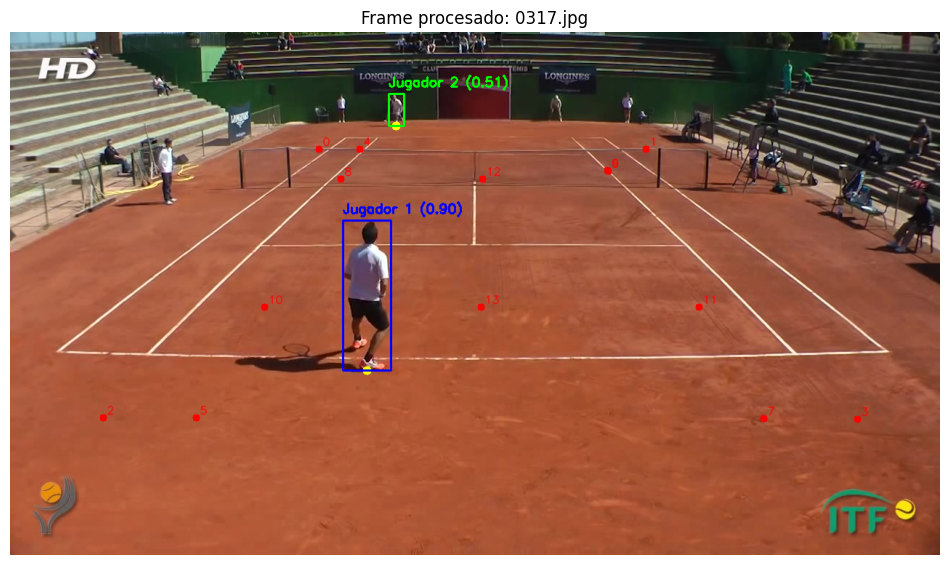

In [ ]:
frames = frames_aleatorios(DATASET_DIR)

# puntos de referencia de la pista
_, court_points = create_tennis_court_reference()

for img_path in frames:
    pipeline_kp_3_pies_homografia(img_path, modelo, detector, court_points)

Los resultados obtenidos muestran ahora una **mejora clara** con respecto a las pruebas anteriores. En los frames analizados, **ambos jugadores son detectados y asignados correctamente a su mitad correspondiente de la pista**.

A diferencia de los enfoques previos, el uso de la **homografía inversa** realmente **supone una gran ventaja** al desacoplarse del impacto que supone la proyección y perspectiva de la cámara. Esto resulta especialmente bueno para el **jugador superior**, que en las pruebas anteriores era el **más propenso a errores**.

Además, el **uso del punto central inferior de la bounding box**, como aproximación a la **posición real de los pies del jugador**, aporta una representación **más significativa del contacto del jugador con la pista** que el centro.

En conjunto, los resultados visuales confirman que esta estrategia es la **más robusta, consistente y fiel al comportamiento real de los jugadores hasta ahora**, logrando una **asignación correcta en la gran mayoría de los casos analizados**, lo que valida la hipótesis inicial de que operar en el plano de la pista, en lugar del plano de la imagen, es clave para una buena detección de jugadores.



---

Para complementar los resultados obtenidos sobre un **frame individual**, se aplica sobre **clips completos de vídeo**, permitiendo evaluar su comportamiento en un escenario temporal continuo.

Debido al **alto coste computacional** asociado a la detección y refinamiento de los keypoints de la pista, principalmente en **tiempo de cómputo**, la estimación de los keypoints y el cálculo de la homografía **no se realiza en cada frame**, sino **cada 7 frames**, puesto que realmente, la **geometría de la pista para un mismo clip permanece invariante** a lo largo de un clip, mientras que los jugadores son los elementos dinámicos de la escena.

Al igual que los keypoints detectados y la homografía se **reutilizan** durante varios frames consecutivos, los keypoints virtuales calculados también.


In [ ]:
fps = 30
img_dir = "data/tracknet/Dataset/game7/Clip4"
img_paths = sorted(glob.glob(os.path.join(img_dir, "*.jpg")))

out_path = "players_tracking_kp_pies_homografia.mp4"
fourcc = cv2.VideoWriter_fourcc(*"mp4v")
video_writer = cv2.VideoWriter(out_path, fourcc, fps, (W, H))

# puntos de referencia de la pista
_, court_points = create_tennis_court_reference()

H = None
court_keypoints = None

for frame_idx, img_path in enumerate(img_paths):

    # se carga la imagen
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # se actualizan los keypoints reales + homografía cada 7 frames
    if frame_idx % 7 == 0 or H is None:
        try:
            _, court_keypoints, H = process_court_image(
                img_path,
                detector,
                crop_size=110
            )
        except Exception as e:
            print(f"Error frame {frame_idx}: {e}")
            H = None
            court_keypoints = None

    # si no hay keypoints válidos, se escribe el frame limpio
    if H is None or court_keypoints is None:
        video_writer.write(img)
        continue

    img_out = img.copy()

    # yolo
    results = modelo(img_rgb, conf=0.4, classes=[0], verbose=False)

    bboxes_players = []
    for r in results:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            bboxes_players.append({
                "bbox": [int(x1), int(y1), int(x2), int(y2)],
                "conf": conf
            })

    if len(bboxes_players) < 2:
        video_writer.write(img_out)
        continue

    # se calcula el centro inferior de los bbox (pies)
    for bb in bboxes_players:
        x_c, y_c = bbox_center_pies(bb["bbox"])
        bb["x_c"] = x_c
        bb["y_c"] = y_c

    # keypoints virtuales en pista
    kp_top_court, kp_bottom_court = kp_virtuales(court_points)

    # se asignan los jugadores por los pies y la homografia inversa
    top_player, bottom_player = asigna_jugadores_por_pies(
        bboxes_players,
        kp_top_court,
        kp_bottom_court,
        H
    )

    if top_player is None or bottom_player is None:
        video_writer.write(img_out)
        continue

    # --- dibujado sobre la imagen de salida ---

    # keypoints reales
    img_out = detector.draw_keypoints(
        img_out,
        court_keypoints.reshape(-1)
    )

    # pies de los jugadores seleccionados
    # jugador superior
    if top_player is not None:
        cv2.circle(
            img_out,
            (top_player["x_c"], top_player["y_c"]),
            6,
            (0, 255, 255),  # amarillo
            -1
        )
    # jugador inferior
    if bottom_player is not None:
        cv2.circle(
            img_out,
            (bottom_player["x_c"], bottom_player["y_c"]),
            6,
            (0, 255, 255),  # amarillo
            -1
        )

    # bbox de los jugadores seleccionados
    img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    video_writer.write(img_out)
video_writer.release()
print("Vídeo generado:", out_path)

Vídeo generado: players_tracking_kp_pies_homografia.mp4


In [ ]:
!ffmpeg -y -i players_tracking_kp_pies_homografia.mp4 -vcodec libx264 -pix_fmt yuv420p players_tracking_kp_pies_homografia_fix.mp4 > /dev/null 2>&1
display(Video("players_tracking_kp_pies_homografia_fix.mp4", embed=True))

Para comprobar de forma objetiva si esta ténica supone una **mejora real** con respecto a la prueba anterior, se aplica **sobre el mismo clip** utilizado previamente.

Los resultados muestran una mejora clara: la **detección del jugador superior pasa a ser prácticamente continua a lo largo de todo el clip**, incluso en situaciones donde en la prueba anterior se producen pérdidas o confusiones con otras personas.

Esto confirma que trabajar en el **plano de la pista mediante la homografía inversa**, junto con el uso del **centro de los pies como referencia** permite desacoplar la asignación de jugadores del impacto de la perspectiva de la cámara, siendo un filtrado mucho **más robusto y consistente**.


## **CONSTRUCCIÓN DE MÉTRICAS: DISTANCIA ACUMULADA**

Tras haber conolidado el pipeline de **detección, asignación y seguimiento temporal de jugadores**, en este apartado del notebook se define la **distancia acumulada recorrida por cada jugador** a lo largo del clip como métrica complementaria a lo ya realizado anteriormente.

Es importante tener en cuenta que esta métrica la hemos planteado como una **estimación** ya que no se dispone de información directa del partido. Para ello, se ha utilizado una **escala aproximada** basada en la altura media de los jugadores de tenis:

In [ ]:
ALTURA_JUGADOR_ESTIMADA = 1.80

Y hemos aprovechado la **información geométrica** extraída en cada frame del clip y almacenada en la estructura `datos_trackeo`, donde ahora, para cada frame se va a registrar la **posición de los pies del jugador** y la **bbox** asociada, utilizada como referencia de escala.

Dado que la detección de jugadores, aunque **muy eficiente gracias al pipeline final**, puede fallar puntualmente en algunos frames, se utiliza la **interpolación temporal de posiciones** ya implementada anteriormente (`interpola_posiciones()`). Así, conseguimos garantizar una señal consistente para el cálculo de métricas.




### **IMPLEMENTACIÓN DE LA MÉTRICA**

En primer lugar, el principal problema que tenemos es que estamos trabajando sobre imágenes, y por tanto, sobre píxeles.

Para poder estimar distancias reales a partir de medidas en píxeles, es necesario aplicar una **relación de escala** entre el espacio de la imagen y el mundo real. Para ello, y tal y como se dijo anteriormente, esta escala se define a partir de una **altura de referencia conocida del jugador**, expresada tanto en metros como en píxeles.

De esta manera, las funciones `distancia_pixeles_a_metros()` y `metros_a_distancia_pixeles()` implementan esta relación mediante una **proporcionalidad directa**, asumiendo que la **relación entre píxeles y metros es constante** para un mismo jugador en un frame concreto. Así, una **distancia medida en píxeles** puede transformarse a **metros** (y viceversa) utilizando la **altura del jugador como referencia**.



In [ ]:
# función que convierte una distancia medida en píxeles a metros
# usando una altura de referencia conocida (en metros y píxeles)
def distancia_pixeles_a_metros(distancia_px, ref_altura_m, ref_altura_px):
    return (distancia_px * ref_altura_m) / ref_altura_px

# función que conviernte una distancia en metros a píxeles usando la misma
# relación de proporcionalidad basada en la altura del jugador
def metros_a_distancia_pixeles(metros, ref_altura_m, ref_altura_px):
    return (metros * ref_altura_px) / ref_altura_m

Por otro lado, la función `altura_bbox_px()` ha sido definida para **obtener la altura de una bounding box en píxeles**, considerándola como **estimación de la altura del jugador en la imagen**.


In [ ]:
# función que calcula la altura de una bbox en px
def altura_bbox_px(bbox):
    x1, y1, x2, y2 = bbox
    return max(1, (y2 - y1))  # max(1, ...) evita división por 0

Para calcular la **altura de referencia de un jugador en cada frame (px)** ya mencionada anteriormente, se define `calcula_ref_altura_px()`, que la construye a partir de la información de trackeo almacenada en `datos_trackeo`.

Su comportamiento se divide en tres casos distintos:

* Si existe una **bbox válida**, se extrae su altura en píxeles mediante la función  `altura_bbox_px()`. El resultado es un vector de alturas en el que los frames sin detección quedan inicializados a **None**.
* Como el **tracking no es perfectamente continuo**, si en un frame **no existe detección valida**, se reutiliza la última altura conocida, manteniendo una referencia coherente incluso en frames donde el detector ha fallado.
* Además, si los **primeros frames del clip no contienen detecciones**, toman el valor de la primera altura válida que se encuentre. garantizando tener referencias desde el primer frame del vídeo.



In [ ]:
# función que calcula una referencia de altura en píxeles para cada frame
# a partir de las bounding boxes detectadas
def calcula_ref_altura_px(datos_trackeo, key_bbox):
    N = len(datos_trackeo)
    ref = np.full(N, np.nan, dtype=np.float32)

    # si se detecta bbox, nos quedamos con su altura en px
    for i in range(N):
        bbox = datos_trackeo[i].get(key_bbox, None)
        if bbox is not None:
            ref[i] = altura_bbox_px(bbox)

    # si no se detecta se le atribuye el ultimo valor de altura valido
    ultimo_ref = np.nan
    for i in range(N):
        if not np.isnan(ref[i]):
            ultimo_ref = ref[i]
        else:
            ref[i] = ultimo_ref

    # si los primeros frames no tienen detección,
    # se rellena con la primera altura válida encontrada
    primera_valida = None
    for i in range(N):
        if not np.isnan(ref[i]):
            primera_valida = ref[i]
            break

    if primera_valida is None:
        raise ValueError(f"No hay ninguna bbox válida en '{key_bbox}'")

    for i in range(N):
        if np.isnan(ref[i]):
            ref[i] = primera_valida
        else:
            break

    return ref

Una vez recopilada la **información temporal** de cada frame, las **posiciones interpoladas** de cada jugador y **la referencia de altura en píxeles**, ya tenemos todo lo necesario para el cálculo de la métrica: **distancia acumulada recorrida a lo largo del clip**.

Para ello, a partir de las posiciones interpoladas y para cada par de frames consecutivos, se calcula la **distancia euclídea en píxeles** entre ambas posiciones:

```python3
x1, y1 = posis_interp[i-1]
x2, y2 = posis_interp[i]
```

que representa una **estimación del desplazamiento instantáneo del jugador entre dos instantes temporales consecutivos**.

Finalmente, estas distancias **convertidas a metros** se van **acumulando incrementalmente** para representar la **distancia total recorrida por el jugador** hasta cada frame del vídeo.

In [ ]:
# función que calcula la distancia acumulada frame a frame
def calcula_distancia_acumulada(posis_interp, refs_altura_px):
    distancia_acumulada = np.zeros(len(posis_interp), dtype=np.float32)

    total = 0.0
    for i in range(1, len(posis_interp)):
        # posicion del jugador en el frame anterior
        x1, y1 = posis_interp[i-1]
        # posicion del jugador en el frame actual
        x2, y2 = posis_interp[i]

        # dist recorrida entre ambos frames en px
        dist_px = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)

        # conversion de px a mtros utilizando la altura estimada
        # y la altura de ref en px
        dist_m = distancia_pixeles_a_metros(dist_px, ALTURA_JUGADOR_ESTIMADA, refs_altura_px[i])

        # se acumula la distancia recorrida
        total += dist_m
        distancia_acumulada[i] = total

    return distancia_acumulada

In [ ]:
# funcion auxiliar que dibuja el hud en el que se muestran las distancias de ambos jugadores
def dibuja_hud(top_dist, bottom_dist, img, alpha=0.6):
    # nos quedamos con el ancho de la imagen
    _, W = img.shape[:2]

    hud_x = W - 420
    hud_y = 20
    hud_w = 400
    hud_h = 90

    # fondo semitransparente
    overlay = img.copy()
    cv2.rectangle(
        overlay,
        (hud_x, hud_y),
        (hud_x + hud_w, hud_y + hud_h),
        (0, 0, 0),
        -1
    )

    img_out = cv2.addWeighted(overlay, alpha, img, 1 - alpha, 0)

    # texto
    cv2.putText(
        img_out,
        f"Top player: {top_dist:.2f} m",
        (hud_x + 20, hud_y + 35),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.75,
        (255, 255, 255),
        2
    )

    cv2.putText(
        img_out,
        f"Bottom player: {bottom_dist:.2f} m",
        (hud_x + 20, hud_y + 70),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.75,
        (255, 255, 255),
        2
    )

    return img_out

In [ ]:
# funcion que recoge el pipeline para el trackeo de la dist acumulada
def trackeo_distancias_acumuladas(modelo, detector):
    # lista donde vamos a guardar la info del top/bottom player en cada frame
    datos_trackeo = []

    for frame_idx, img_path in enumerate(img_paths):
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # almacena:
        # numero de frame, (cx_top, cy_top), (cx_bottom, cy_bottom), bbox_top, bbox_bottom
        # si en un frame no detecta al jugador -> none (es lo que nos interesa saber)
        frame_info = {
            "frame_idx": frame_idx,
            "top_player": None,        # (x_pies, y_pies)
            "bottom_player": None,     # (x_pies, y_pies)
            "top_bbox": None,
            "bottom_bbox": None
        }

        # se obtienen y refinan los kp reales + homografia cada 7 frames
        if frame_idx % 7 == 0 or H is None:
            try:
                _, court_keypoints, H = process_court_image(
                    img_path,
                    detector,
                    crop_size=110
                )
            except Exception:
                H = None
                court_keypoints = None

        if H is None or court_keypoints is None:
            datos_trackeo.append(frame_info)
            continue

        # deteccion de personas con yolo
        predicciones = modelo(img_rgb, conf=0.4, classes=[0], verbose=False)

        bboxes_players = []
        for r in predicciones:
            for bbox in r.boxes:
                x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
                bboxes_players.append({
                    "bbox": [int(x1), int(y1), int(x2), int(y2)]
                })

        if len(bboxes_players) < 2:
            datos_trackeo.append(frame_info)
            continue

        # calculo de pies para cada bbox registrada
        for bb in bboxes_players:
            bb["x_c"], bb["y_c"] = bbox_center_pies(bb["bbox"])

        # calculo de los kp virtuales
        kp_top_court, kp_bottom_court = kp_virtuales(court_points)

        # seleccion de jugadores mediante kp virtuales y h inversa
        top_player, bottom_player = asigna_jugadores_por_pies(
            bboxes_players,
            kp_top_court,
            kp_bottom_court,
            H
        )

        if top_player is not None:
            # guardamos el centro del jug superior para interpolar los frames
            frame_info["top_player"] = (top_player["x_c"], top_player["y_c"])
            # guardamos las bbox
            frame_info["top_bbox"] = top_player["bbox"]

        if bottom_player is not None:
            # guardamos el centro del jug inferior para interpolar los frames
            frame_info["bottom_player"] = (bottom_player["x_c"], bottom_player["y_c"])
            # guardamos las bbox
            frame_info["bottom_bbox"] = bottom_player["bbox"]

        datos_trackeo.append(frame_info)

    # calculo de las alturas de referencia en pixeles para cada jugador segun bbox
    top_ref_altura_px = calcula_ref_altura_px(datos_trackeo, "top_bbox")
    bottom_ref_altura_px = calcula_ref_altura_px(datos_trackeo, "bottom_bbox")

    # interpolacion de posiciones
    top_interp = interpola_posiciones(datos_trackeo, "top_player")
    bottom_interp = interpola_posiciones(datos_trackeo, "bottom_player")

    # calculo de la dist acumulada en cada frame
    top_dist_acumulada = calcula_distancia_acumulada(
        top_interp,
        top_ref_altura_px
    )

    bottom_dist_acumulada = calcula_distancia_acumulada(
        bottom_interp,
        bottom_ref_altura_px
    )

    return top_dist_acumulada, bottom_dist_acumulada, datos_trackeo

De esta manera, el pipeline final para el **cálculo de la distancia acumulada por cada jugador** a lo largo de un clip se compone de **dos fases**.

En primer lugar, se llama a `trackeo_distancias_acumuladas()` para construir los requisitos necesarios para ello, como `datos_trackeo` y las **posiciones interpoladas**, que nos permite calcular la distancia para ambos jugadores.



In [ ]:
fps = 30
img_dir = "data/tracknet/Dataset/game7/Clip4"
img_paths = sorted(glob.glob(os.path.join(img_dir, "*.jpg")))

# se genera el detector con los pesos ya preentrenados
detector = CourtLineDetector("drive/MyDrive/model_court.pth")

# puntos de referencia de la pista (court view)
_, court_points = create_tennis_court_reference()

H = None
court_keypoints = None

# calculo de las dist acumuladas para cada jugador
top_dist_acumulada, bottom_dist_acumulada, datos_trackeo = trackeo_distancias_acumuladas(modelo, detector)

Finalmente, se vuelve a recorrer cada frame del clip, en este caso, para dibujar el **hud con la métrica ya calculada** así como los **keypoints reales**, **bbox**...

In [ ]:
out_path = "players_tracking_dist_hud.mp4"
fourcc = cv2.VideoWriter_fourcc(*"mp4v")

img_test = cv2.imread(img_paths[0])
H, W = img_test.shape[:2]

video_writer = cv2.VideoWriter(out_path, fourcc, fps, (W, H))

H = None
court_keypoints = None

for frame_idx, img_path in enumerate(img_paths):
    # cargado de la imagen
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # actualizar keypoints + homografía cada 7 frames
    if frame_idx % 7 == 0 or H is None:
        try:
            _, court_keypoints, H = process_court_image(
                img_path, detector, crop_size=110
            )
        except Exception:
            H = None
            court_keypoints = None

    if H is None or court_keypoints is None:
        video_writer.write(img)
        continue

    img_out = img.copy()

    # predicciones con yolo
    predicciones = modelo(img_rgb, conf=0.4, classes=[0], verbose=False)

    bboxes_players = []
    for r in predicciones:
        for bbox in r.boxes:
            x1, y1, x2, y2 = bbox.xyxy[0].cpu().numpy()
            conf = float(bbox.conf[0].cpu().numpy())

            bboxes_players.append({
                "bbox": [int(x1), int(y1), int(x2), int(y2)],
                "conf": conf
            })

    if len(bboxes_players) < 2:
        video_writer.write(img_out)
        continue

    # pies
    for bb in bboxes_players:
        bb["x_c"], bb["y_c"] = bbox_center_pies(bb["bbox"])

    # keypoints virtuales
    kp_top_court, kp_bottom_court = kp_virtuales(court_points)

    # asignación
    top_player, bottom_player = asigna_jugadores_por_pies(
        bboxes_players, kp_top_court, kp_bottom_court, H
    )

    if top_player is None or bottom_player is None:
        video_writer.write(img_out)
        continue

    # ---------------- dibujado ----------------

    # keypoints reales
    img_out = detector.draw_keypoints(
        img_out, court_keypoints.reshape(-1)
    )

    # pies
    cv2.circle(img_out, (top_player["x_c"], top_player["y_c"]), 6, (0,255,255), -1)
    cv2.circle(img_out, (bottom_player["x_c"], bottom_player["y_c"]), 6, (0,255,255), -1)

    # bbox
    img_out = dibuja_bbox_jugadores(img_out, top_player, bottom_player)

    # hud de distancias
    idx = min(frame_idx, len(top_dist_acumulada) - 1)
    img_out = dibuja_hud(top_dist_acumulada[idx], bottom_dist_acumulada[idx], img_out)

    video_writer.write(img_out)

video_writer.release()
print("Vídeo generado:", out_path)

Vídeo generado: players_tracking_dist_hud.mp4


In [ ]:
!ffmpeg -y -i players_tracking_dist_hud.mp4 -vcodec libx264 -pix_fmt yuv420p players_tracking_dist_hud_fix.mp4 > /dev/null 2>&1
display(Video("players_tracking_dist_hud_fix.mp4", embed=True))